<img src="http://s3.amazonaws.com/pix.iemoji.com/images/emoji/apple/ios-12/256/waving-hand.png" align=left width=44, heigth=44>
<div class="alert alert-info">
<b> Комментарий ревьюера</b>


Привет, Анна! Давай знакомиться (хотя мы уже встречались на предыдущем проекте)! Меня зовут Дмитрий Махортов, и я буду проверять твой проект. Сразу предлагаю общение на «ты» 🙂, но если тебе это не комфортно, то дай знать, и мы перейдем на «вы». 


Моя основная цель — не указать на совершенные тобою ошибки, а поделиться своим опытом и помочь тебе погрузиться в увлекательный мир работы с данными и вырасти в крепкого профи. Это отдаленная цель. А ближайшая - сделать твою работу еще лучше )).
   
    
Все ключевые этапы в работе выполнены, и я вижу что с проектом ты справшяешься. Есть моменты, которые нужно доработать, но я уверен, у тебя все получится.
        
Расскажу как обычно проходит проверка:    
Бывают моменты, которые требуют пристального внимания. Комментарии по ним выделены <span style='background-color:#F7B3A4'> красным цветом </span> и обозначены значком 🛑. После их доработки проект будет принят.  🙂
 
<span style='background-color:#B7EBA7'> Зеленым цветом </span> и значком ✅ отмечены удачные и элегантные решения, на которые можно опираться в будущих проектах. Или советы «со звездочкой», которые помогут тебе в будущем.

<span style='background-color:#F9EDA6'>Жёлтым цветом </span> и значком ⚠️ выделено то, что в следующий раз можно сделать по-другому. Ты можешь учесть эти комментарии при выполнении будущих заданий или доработать проект сейчас (однако это не обязательно).

Давай работать над проектом в диалоге: **если ты что-то меняешь в проекте по моим рекомендациям — пиши об этом**. Выбери для своих комментариев какой-то заметный цвет, так мне будет легче отследить изменения. Пожалуйста, **не перемещай, не изменяй и не удаляй мои комментарии**. Всё это поможет выполнить повторную проверку твоего проекта оперативнее. 
</div>

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
    <font size="3"><b>образец комментария студента</b></font>
   
Можешь использовать этот комментарий. Просто удали этот текст и вместо него напиши свой 🙂

</div>

## Поиск по изображениям
Нужно разработать демонстрационную версию поиска изображений по запросу.

Для демонстрационной версии нужно обучить модель, которая получит векторное представление изображения, векторное представление текста, а на выходе выдаст число от 0 до 1 — покажет, насколько текст и картинка подходят друг другу.

1.  Описание данных

* В файле train_dataset.csv находится информация, необходимая для обучения: имя файла изображения, идентификатор описания и текст описания. Для одной картинки может быть доступно до 5 описаний. Идентификатор описания имеет формат <имя файла изображения>#<порядковый номер описания>.

* В папке train_images содержатся изображения для тренировки модели.

* В файле CrowdAnnotations.tsv — данные по соответствию изображения и описания, полученные с помощью краудсорсинга. Номера колонок и соответствующий тип данных:

** Имя файла изображения.
** Идентификатор описания.
** Доля людей, подтвердивших, что описание соответствует изображению.
** Количество человек, подтвердивших, что описание соответствует изображению.
** Количество человек, подтвердивших, что описание не соответствует изображению.

* В файле ExpertAnnotations.tsv содержатся данные по соответствию изображения и описания, полученные в результате опроса экспертов. Номера колонок и соответствующий тип данных:

** Имя файла изображения.
** Идентификатор описания.
** 3, 4, 5 — оценки трёх экспертов.

Эксперты ставят оценки по шкале от 1 до 4, где 1 — изображение и запрос совершенно не соответствуют друг другу, 2 — запрос содержит элементы описания изображения, но в целом запрос тексту не соответствует, 3 — запрос и текст соответствуют с точностью до некоторых деталей, 4 — запрос и текст соответствуют полностью.

* В файле test_queries.csv находится информация, необходимая для тестирования: идентификатор запроса, текст запроса и релевантное изображение. Для одной картинки может быть доступно до 5 описаний. Идентификатор описания имеет формат <имя файла изображения>#<порядковый номер описания>.

* В папке test_images содержатся изображения для тестирования модели.


<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
 👍 Да, это хорошая практика - дать описание контекста и проблемы, которую мы решаем. </div>

## 1. Исследовательский анализ данных

Наш датасет содержит экспертные и краудсорсинговые оценки соответствия текста и изображения.

В файле с экспертными мнениями для каждой пары изображение-текст имеются оценки от трёх специалистов. Для решения задачи Мы должны эти оценки агрегировать — превратить в одну. Существует несколько способов агрегации оценок, самый простой — голосование большинства: за какую оценку проголосовала большая часть экспертов (в нашем случае 2 или 3), та оценка и ставится как итоговая. Поскольку число экспертов меньше числа классов, может случиться, что каждый эксперт поставит разные оценки, например: 1, 4, 2. В таком случае данную пару изображение-текст можно исключить из датасета.

Мы можеМ воспользоваться другим методом агрегации оценок или придумать свой.

В файле с краудсорсинговыми оценками информация расположена в таком порядке:

1. Доля исполнителей, подтвердивших, что текст **соответствует** картинке.
2. Количество исполнителей, подтвердивших, что текст **соответствует** картинке.
3. Количество исполнителей, подтвердивших, что текст **не соответствует** картинке.

После анализа экспертных и краудсорсинговых оценок выберите либо одну из них, либо объедините их в одну по какому-то критерию: например, оценка эксперта принимается с коэффициентом 0.6, а крауда — с коэффициентом 0.4.

Hаша модель должна возвращать на выходе вероятность соответствия изображения тексту, поэтому целевая переменная должна иметь значения от 0 до 1.

In [1]:
!pip install sqlalchemy pandas matplotlib seaborn skorch scikit-learn scipy statsmodels prophet -q
!pip install numpy==1.26 -q


In [2]:
%cd '/home/anna/Search by image photohosting "With Sense"/foto'

[Errno 2] No such file or directory: '/home/anna/Search by image photohosting "With Sense"/foto'
/home/anna/Search by image photohosting “With Sense”


In [3]:
!mkdir -p nltk_data/tokenizers/

In [4]:
!unzip -u punkt_tab.zip -d nltk_data/tokenizers/

unzip:  cannot find or open punkt_tab.zip, punkt_tab.zip.zip or punkt_tab.zip.ZIP.


In [5]:
import os
import nltk
current_dir = os.getcwd()
nltk_data_path = os.path.join(current_dir, 'nltk_data')
nltk.data.path.append(nltk_data_path)

In [6]:
#print(nltk.data.path)

In [7]:
pip install nltk lightgbm xgboost keras_nlp -q

Note: you may need to restart the kernel to use updated packages.


In [8]:
pip install tf-keras -q

Note: you may need to restart the kernel to use updated packages.


In [9]:
pip install sentence-transformers tensorflow -q

Note: you may need to restart the kernel to use updated packages.



<img src="https://upload.wikimedia.org/wikipedia/commons/b/ba/Warning_sign_4.0.png" align=left width=44, heigth=33>
<div class="alert alert-warning">
Вижу очень много установок, но мне кажется большая часть из них лишняя - похоже ты доставляла недостающие библиотеки локально.
    
Кроме этого у тебя много библиотек, которые в этом проекте вообще не нужны,  тот же skorch (в проекте ты используешь keras), prophet для анализав ременных рядов и т.д.
    
Есть смысл попробовать стартовать от какого-нибудь стандартного окружения (хоть от того же Google Colab) и доставлять только те библиотеки, которые не входят в существующее окружение.
    
А ставить все подряд "на всякий случай" не лучшая идея.    
    
</div>

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
    <font size="3"><b>комментарии студента</b></font>
    Да ты несомненно прав, практика одно окружение на все проекты не совсем верная . хотя можно подобрать то , что будет задейсвтованно практически всегдаю Но твой посыл я поняла и согласна с ним


In [10]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
import seaborn as sns

import re

import nltk
from nltk.corpus import stopwords as nltk_stopwords, wordnet
from nltk.stem import WordNetLemmatizer
#from sklearn.feature_extraction.text import TfidfVectorizer

from collections import Counter

stopwords = set(nltk_stopwords.words('english'))

nltk.download('stopwords') # поддерживает удаление стоп-слов
nltk.download('punkt') # делит текст на список предложений
nltk.download('wordnet') # проводит лемматизацию
nltk.download('omw-1.4')

#from sentence_transformers import SentenceTransformer
from PIL import Image


from tensorflow.keras.layers import (Dense, GlobalAveragePooling2D, Flatten, Dropout, BatchNormalization)
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam,AdamW
from tensorflow.keras.regularizers import l2

from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.resnet import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input
from tensorflow import keras
import tensorflow as tf
import keras_nlp
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
from keras import backend as K
from tqdm.notebook import tqdm






import sklearn
from sklearn.model_selection import RandomizedSearchCV,cross_val_score
from sklearn.preprocessing import StandardScaler


from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.dummy import DummyRegressor


#from sklearn.preprocessing import MaxAbsScaler


from sklearn.metrics import make_scorer, mean_squared_error
import itertools

from sklearn.metrics import classification_report, confusion_matrix



from sklearn.model_selection import GroupShuffleSplit


[nltk_data] Downloading package stopwords to /home/anna/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /home/anna/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /home/anna/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /home/anna/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
2024-10-08 22:51:28.359024: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-10-08 22:51:28.363993: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-10-08 22:51:28.379467: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-10-08 22:

<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
Отлично, все нужные библиотеки импортированы в начале ноутбука.Это хорошая практика.</div>

In [11]:
import ssl

try:
    _create_unverified_https_context = ssl._create_unverified_context
except AttributeError:
    pass
else:
    ssl._create_default_https_context = _create_unverified_https_context

nltk.download('punkt')

[nltk_data] Downloading package punkt to /home/anna/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

<img src="https://upload.wikimedia.org/wikipedia/commons/b/ba/Warning_sign_4.0.png" align=left width=44, heigth=33>
<div class="alert alert-warning">
Я регулярно встречаю эту конструкцию с ssl и она всегда вызывает у меня вопросы. У меня никогда не возниало проблем со скачиванием необходимых пакетов nltk. Просто запускаешь и всё. Впрочем я работаю под linux, возможно это какой-то вынжуденный "костыль" для win?
    

</div>

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
    <font size="3"><b>комментарии студента</b></font>
Ты удивишься !Но я я работаю на Linux Debian и это моя боль , которую нужно стойко пройти.(это был осознанный выбор)
при выполнении проекта локально, что бы я не делала возникала ошибка
, поэтому так много загрузок связанных с nltk.
    
ИТОГО: И я просто все обновила до последних версий, были конфликты(странно почему я сразу об этом не подумла, прежде чем загружать все это ), я попробую поудалять и почистить окружение после сдачи проекта. Пришлось ниже немного поменять код, но на фунционал никак не влияет, даже симпатичнее графики стали. 😅

In [12]:
print(f"NumPy version: {np.__version__}")
print(f"Pandas version: {pd.__version__}")
print(f"Matplotlib version: {plt.matplotlib.__version__}")
print(f"Scikit-learn version: {sklearn.__version__}")
print(f"nltk version: {nltk.__version__}")

NumPy version: 1.26.0
Pandas version: 1.5.3
Matplotlib version: 3.8.0
Scikit-learn version: 1.3.1
nltk version: 3.9.1


<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
 👍 </div>

In [13]:
PATH = '/home/anna/Search by image photohosting “With Sense”/to_upload'
SEED = 3456
BLOCK =  [
    'child', #ребенок
    'kid', #ребенок (разг.)
    'kids', #дети (разг.)
    'teenager', #подросток
    'teen', #подросток
    'teenage', #подростковый
    'adolescent', #подросток
    'minor', #несовершеннолетний
    'youngster', #юнец, молодой человек
    'youngling', #юнец (часто в научной фантастике)
    'youth', #молодежь, юноша
    'young', #молодой
    'juvenile', #подросток, несовершеннолетний
    'tween', #предподросток (9-12 лет)
    'preteen', #предподросток
    'toddler', #ребенок, начинающий ходить (1-3 года)
    'infant', #младенец
    'baby', #малыш
    'newborn', #новорожденный
    'junior', #младший
    'tyke', #малыш (разг.)
    'preschooler', #дошкольник
    'boy', #мальчик
    'boys', #мальчики
    'girls', #девочки
    'girl' #девочка
         ]

np.random.seed(SEED)
tf.random.set_seed(SEED)

<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
Большое тебе человеческое спасибо за вынос пути к данным в отдельную константу. Это сэкономило мне немало времени при проверке.</div>

In [14]:
def read_df(path=PATH) -> pd.DataFrame:

    train_dataset = pd.read_csv(Path(path, 'train_dataset.csv'))

    crowd = pd.read_csv(Path(path, 'CrowdAnnotations.tsv'), sep='\t',
                           names=['image', 'query_id', 'share_pos', 'count_pos', 'count_neg'])

    expert = pd.read_csv(Path(path, 'ExpertAnnotations.tsv'), sep='\t',
                           names=['image', 'query_id', 'first', 'second', 'third'])

    test_queries = pd.read_csv(Path(path, 'test_queries.csv'), index_col=[0], sep='|')

    test_images = pd.read_csv(Path(path, 'test_images.csv'), sep='|')

    return train_dataset, crowd, expert, test_queries, test_images

train_dataset, crowd, expert, test_queries, test_images = read_df()

## train_dataset

In [15]:
print('Первые 20 строк:')
#display(train_dataset.head(20))
print(train_dataset.head(20).to_string())


print('\nИнформация:')
print(train_dataset.info())

print('\nКоличество уникальных значений в каждом столбце:')
print(train_dataset.nunique())

print('\nКоличество пропущенных значений:')
print(train_dataset.isnull().sum())

Первые 20 строк:
                        image                     query_id                                                                query_text
0   1056338697_4f7d7ce270.jpg  2549968784_39bfbe44f9.jpg#2  A young child is wearing blue goggles and sitting in a float in a pool .
1   1262583859_653f1469a9.jpg  2549968784_39bfbe44f9.jpg#2  A young child is wearing blue goggles and sitting in a float in a pool .
2   2447284966_d6bbdb4b6e.jpg  2549968784_39bfbe44f9.jpg#2  A young child is wearing blue goggles and sitting in a float in a pool .
3   2549968784_39bfbe44f9.jpg  2549968784_39bfbe44f9.jpg#2  A young child is wearing blue goggles and sitting in a float in a pool .
4   2621415349_ef1a7e73be.jpg  2549968784_39bfbe44f9.jpg#2  A young child is wearing blue goggles and sitting in a float in a pool .
5   3030566410_393c36a6c5.jpg  2549968784_39bfbe44f9.jpg#2  A young child is wearing blue goggles and sitting in a float in a pool .
6   3155451946_c0862c70cb.jpg  2549968784_39bfbe44f9

In [16]:
# Функция для обработки текста
def process_text(text):
    # Приведение к нижнему регистру и разделение на слова
    words = text.lower().split()
    # Удаление стоп-слов и пунктуации
    words = [word for word in words if word.isalnum() and word not in stopwords]
    return words

# Объединение всех описаний
all_words = []
for text in train_dataset['query_text']:
    all_words.extend(process_text(text))

# Подсчет частоты слов
word_freq = Counter(all_words)

# Выбор 20 наиболее часто встречающихся слов
top_words = dict(word_freq.most_common(20))

print(top_words)

{'dog': 1161, 'man': 996, 'two': 841, 'white': 697, 'woman': 561, 'black': 516, 'boy': 511, 'wearing': 450, 'water': 440, 'girl': 439, 'dogs': 408, 'young': 391, 'people': 379, 'red': 367, 'blue': 346, 'little': 305, 'brown': 284, 'running': 268, 'person': 265, 'playing': 245}


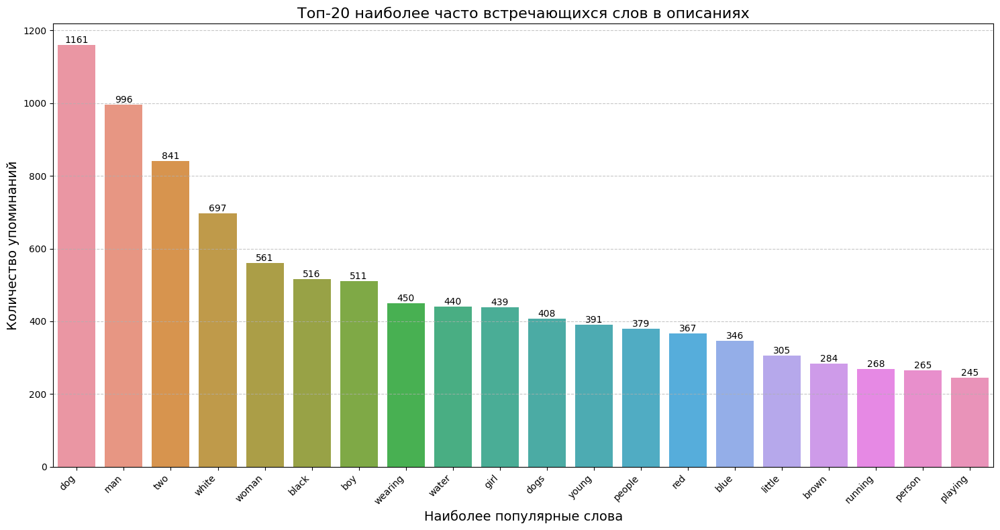

In [17]:
plt.figure(figsize=(15, 8))
ax = sns.barplot(x=list(top_words.keys()), y=list(top_words.values()))

plt.xticks(rotation=45, ha='right')

plt.title('Топ-20 наиболее часто встречающихся слов в описаниях', fontsize=16)
ax.set_xlabel('Наиболее популярные слова', fontsize=14)
ax.set_ylabel('Количество упоминаний', fontsize=14)

for i, v in enumerate(top_words.values()):
    ax.text(i, v, str(v), ha='center', va='bottom')

ax.grid(axis='y', linestyle='--', alpha=0.7)

sns.set_style("whitegrid")
plt.tight_layout()

plt.show()

В файле train_dataset.csv собрана информация, необходимая для обучения: имя файла изображения, идентификатор описания и текст описания.

1. Датасет состоит из 5821 строк. Вывела для наглядности 20 первый строчек. Так же сделала вывод всего текста целиком, мы можем наблюдать ,что у разных изображений может быть одинаковый индификатор описания и текст описания
2. Пропущенных значений нет.
3. Кол-во уникальных изображений 1000 против 5821 строчки датасета
4. Я сделала выборку наиболее популярных слов. Самое распространенное это Собака и мужчина.

<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
 👍 </div>

## test_queries

In [18]:
print('Первые пять строк:')
display(test_queries.head(5))

print('\nИнформация:')
print(test_queries.info())

print('\nКоличество уникальных значений в каждом столбце:')
print(test_queries.nunique())

print('\nКоличество пропущенных значений:')
print(test_queries.isnull().sum())

Первые пять строк:


,query_id,query_text,image
0,1177994172_10d143cb8d.jpg#0,"Two blonde boys , one in a camouflage shirt an...",1177994172_10d143cb8d.jpg
1,1177994172_10d143cb8d.jpg#1,Two boys are squirting water guns at each other .,1177994172_10d143cb8d.jpg
2,1177994172_10d143cb8d.jpg#2,Two boys spraying each other with water,1177994172_10d143cb8d.jpg
3,1177994172_10d143cb8d.jpg#3,Two children wearing jeans squirt water at eac...,1177994172_10d143cb8d.jpg
4,1177994172_10d143cb8d.jpg#4,Two young boys are squirting water at each oth...,1177994172_10d143cb8d.jpg



Информация:
<class 'pandas.core.frame.DataFrame'>
Int64Index: 500 entries, 0 to 499
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   query_id    500 non-null    object
 1   query_text  500 non-null    object
 2   image       500 non-null    object
dtypes: object(3)
memory usage: 15.6+ KB
None

Количество уникальных значений в каждом столбце:
query_id      500
query_text    500
image         100
dtype: int64

Количество пропущенных значений:
query_id      0
query_text    0
image         0
dtype: int64


Тестовые данные состоят из 500 строк, так же нет пропусков.

Не стала подробно расписывать тестовые данные.


<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
Тут можно обратить внимание, что в тестовом наборе все изображения идеально соответствут описаниям. Это хорошо видно если сравнить колонки query_id и image </div>

# CrowdAnnotations.tsv

В файле CrowdAnnotations.tsv — данные по соответствию изображения и описания, полученные с помощью краудсорсинга. Номера колонок и соответствующий тип данных:
* Имя файла изображения.
* Идентификатор описания.
* Доля людей, подтвердивших, что описание соответствует изображению.
* Количество человек, подтвердивших, что описание соответствует изображению.
* Количество человек, подтвердивших, что описание не соответствует изображению.

In [19]:
print('Первые пять строк:')
display(crowd.head(5))

print('\nИнформация:')
print(crowd.info())

print('\nКоличество уникальных значений в каждом столбце:')
print(crowd.nunique())

print('\nКоличество пропущенных значений:')
print(crowd.isnull().sum())

Первые пять строк:


,image,query_id,share_pos,count_pos,count_neg
0,1056338697_4f7d7ce270.jpg,1056338697_4f7d7ce270.jpg#2,1.0,3,0
1,1056338697_4f7d7ce270.jpg,114051287_dd85625a04.jpg#2,0.0,0,3
2,1056338697_4f7d7ce270.jpg,1427391496_ea512cbe7f.jpg#2,0.0,0,3
3,1056338697_4f7d7ce270.jpg,2073964624_52da3a0fc4.jpg#2,0.0,0,3
4,1056338697_4f7d7ce270.jpg,2083434441_a93bc6306b.jpg#2,0.0,0,3



Информация:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 47830 entries, 0 to 47829
Data columns (total 5 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   image      47830 non-null  object 
 1   query_id   47830 non-null  object 
 2   share_pos  47830 non-null  float64
 3   count_pos  47830 non-null  int64  
 4   count_neg  47830 non-null  int64  
dtypes: float64(1), int64(2), object(2)
memory usage: 1.8+ MB
None

Количество уникальных значений в каждом столбце:
image        1000
query_id     1000
share_pos      12
count_pos       6
count_neg       7
dtype: int64

Количество пропущенных значений:
image        0
query_id     0
share_pos    0
count_pos    0
count_neg    0
dtype: int64


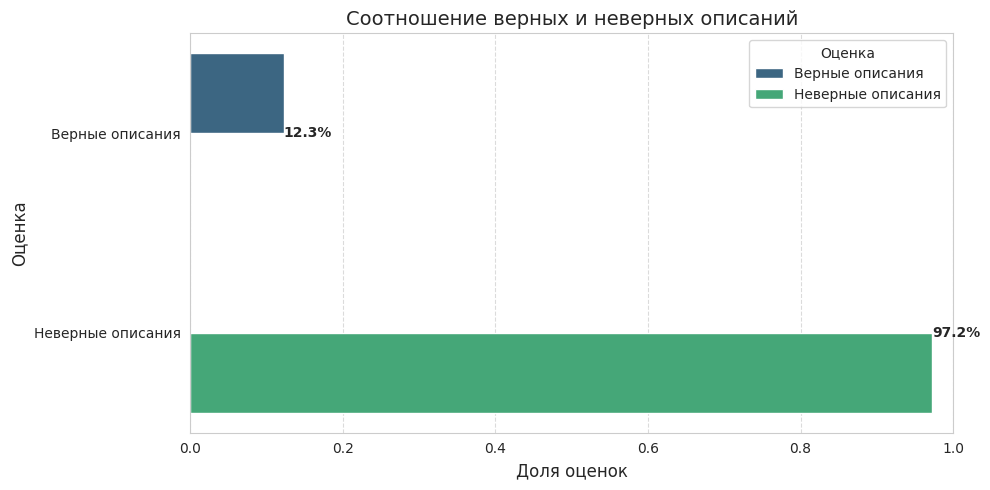

In [20]:
def plot_pos_neg_ratio(crowd):
    data = pd.DataFrame({
        'Оценка': ['Верные описания', 'Неверные описания'],
        'Доля': [
            (crowd['count_pos'] > 0).mean(),
            (crowd['count_neg'] > 0).mean()
        ]
    })

    plt.figure(figsize=(10, 5))
    ax = sns.barplot(x='Доля', y='Оценка', data=data, hue='Оценка', palette='viridis')

    plt.title('Соотношение верных и неверных описаний', fontsize=14)
    plt.xlabel('Доля оценок', fontsize=12)
    plt.ylabel('Оценка', fontsize=12)

    for i, v in enumerate(data['Доля']):
        ax.text(v, i, f'{v:.1%}', va='center', fontweight='bold')

    plt.xlim(0, 1)
    plt.grid(axis='x', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()

plot_pos_neg_ratio(crowd)

В нашем распоряжении 47830 строчек данных
 1. Пропущенных значений нет
 2. Уникальность в каждом столбце отобразили отобразили
 3. Интересно, что 97.2 процента такое количество человек, подтвердивших, что описание не соответствует изображению. Нужно смотреть детально мнение экспертов. Так как перекос значительный будет решать объединять с экспертами или удалить вовсе краудов.

<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
 👍 </div>

## ExpertAnnotations

В файле ExpertAnnotations.tsv  — данные по соответствию изображения и описания, полученные в результате опроса экспертов.

* Номера колонок и соответствующий тип данных:
* Имя файла изображения.
* Идентификатор описания.
* 3, 4, 5 — оценки трёх экспертов.

Оценки и их значение:

 * 1 — изображение и запрос совершенно не соответствуют друг другу
 * 2 — запрос содержит элементы описания изображения, но в целом запрос тексту не соответствует
 * 3 — запрос и текст соответствуют с точностью до некоторых деталей
 * 4 — запрос и текст соответствуют полностью.      

In [21]:
print('Первые пять строк:')
display(expert.head(5))

print('\nИнформация:')
print(expert.info())

print('\nКоличество уникальных значений в каждом столбце:')
print(expert.nunique())

print('\nКоличество пропущенных значений:')
print(expert.isnull().sum())

Первые пять строк:


,image,query_id,first,second,third
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,1,1,1
1,1056338697_4f7d7ce270.jpg,2718495608_d8533e3ac5.jpg#2,1,1,2
2,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,1,1,2
3,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,1,2,2
4,1056338697_4f7d7ce270.jpg,3286822339_5535af6b93.jpg#2,1,1,2



Информация:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Data columns (total 5 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   image     5822 non-null   object
 1   query_id  5822 non-null   object
 2   first     5822 non-null   int64 
 3   second    5822 non-null   int64 
 4   third     5822 non-null   int64 
dtypes: int64(3), object(2)
memory usage: 227.5+ KB
None

Количество уникальных значений в каждом столбце:
image       1000
query_id     977
first          4
second         4
third          4
dtype: int64

Количество пропущенных значений:
image       0
query_id    0
first       0
second      0
third       0
dtype: int64


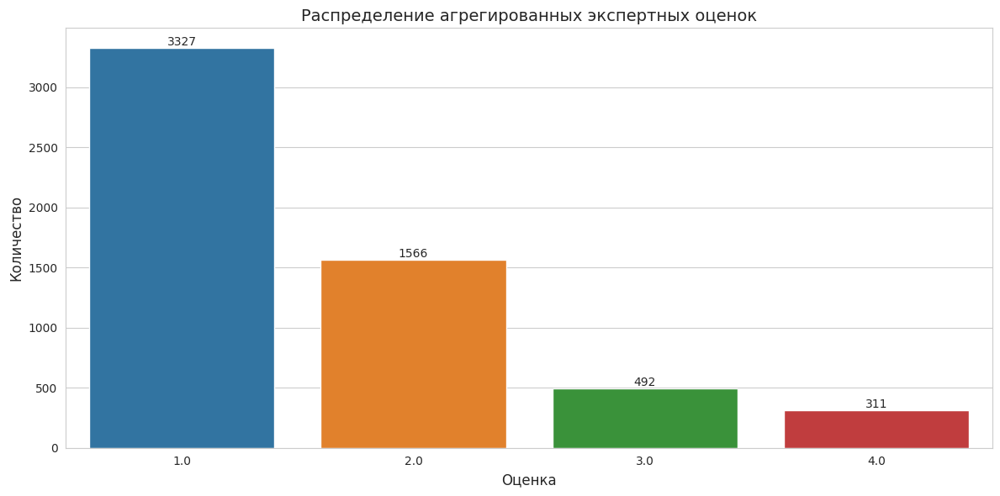

Всего пар изображение-текст: 5822
Исключено пар: 126 (2.16%)

Распределение агрегированных оценок:
1.0    3327
2.0    1566
3.0     492
4.0     311

Средняя агрегированная оценка: 1.61

Распределение бинарных оценок:
0    4893
1     803

Новый датасет с агрегированными и бинарными оценками сохранен в 'aggregated_expert_ratings_binary.csv'


In [22]:
def aggregate_expert_ratings(expert):
    def majority_vote(row):
        votes = row[['first', 'second', 'third']]
        unique_votes = votes.nunique()
        if unique_votes == 1:
            return votes.iloc[0]
        elif unique_votes == 2:
            return votes.mode().iloc[0]
        else:
            return None  # Все эксперты поставили разные оценки

    expert['aggregated_score'] = expert.apply(majority_vote, axis=1)

    # Создаем новый датасет только с агрегированными оценками
    aggregated_df = expert[['image', 'query_id', 'aggregated_score']].dropna()

    # Добавляем бинарную классификацию
    aggregated_df['binary_score'] = aggregated_df['aggregated_score'].apply(lambda x: 1 if x >= 3 else 0)

    return expert, aggregated_df

def analyze_expert_ratings(expert):
    # Агрегируем оценки
    expert, aggregated_df = aggregate_expert_ratings(expert)

    # Подсчитываем распределение агрегированных оценок
    score_distribution = aggregated_df['aggregated_score'].value_counts().sort_index()

    # Создаем график
    plt.figure(figsize=(12, 6))
    sns.barplot(x=score_distribution.index, y=score_distribution.values)

    plt.title('Распределение агрегированных экспертных оценок', fontsize=14)
    plt.xlabel('Оценка', fontsize=12)
    plt.ylabel('Количество', fontsize=12)

    # Добавляем значения на столбцы
    for i, v in enumerate(score_distribution.values):
        plt.text(i, v, str(v), ha='center', va='bottom')

    plt.tight_layout()
    plt.show()

    # Выводим статистику
    total_pairs = len(expert)
    excluded_pairs = expert['aggregated_score'].isna().sum()
    print(f"Всего пар изображение-текст: {total_pairs}")
    print(f"Исключено пар: {excluded_pairs} ({excluded_pairs/total_pairs:.2%})")
    print("\nРаспределение агрегированных оценок:")
    print(score_distribution.to_string())
    print(f"\nСредняя агрегированная оценка: {aggregated_df['aggregated_score'].mean():.2f}")

    # Выводим распределение бинарных оценок
    binary_distribution = aggregated_df['binary_score'].value_counts().sort_index()
    print("\nРаспределение бинарных оценок:")
    print(binary_distribution.to_string())

    return aggregated_df


aggregated_expert_binary = analyze_expert_ratings(expert)

# Сохраняем новый датасет с агрегированными оценками
aggregated_expert_binary.to_csv('aggregated_expert_ratings_binary.csv', index=False)
print("\nНовый датасет с агрегированными и бинарными оценками сохранен в 'aggregated_expert_ratings_binary.csv'")

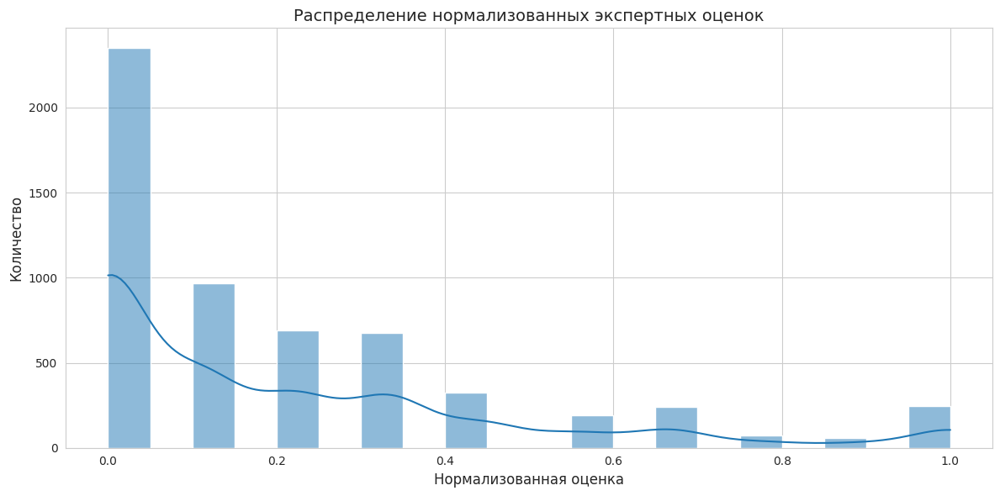

Всего пар изображение-текст: 5822

Средняя агрегированная оценка: 1.65
Средняя нормализованная оценка: 0.2159

Распределение нормализованных оценок:
25% квантиль: 0.0000
Медиана: 0.1111
75% квантиль: 0.3333

Новый датасет с агрегированными и нормализованными оценками сохранен в 'aggregated_expert_ratings.csv'


In [23]:
def aggregate_expert_ratings(expert):
    # Используем среднее значение вместо мажоритарного голосования
    expert['aggregated_score'] = expert[['first', 'second', 'third']].mean(axis=1)

    # Нормализуем оценки в диапазон 0-1
    expert['normalized_score'] = (expert['aggregated_score'] - 1) / 3

    # Создаем новый датасет с агрегированными и нормализованными оценками
    aggregated_df = expert[['image', 'query_id', 'aggregated_score', 'normalized_score']]

    return expert, aggregated_df

def analyze_expert_ratings(expert):
    # Агрегируем оценки
    expert, aggregated_df = aggregate_expert_ratings(expert)

    # Создаем график распределения нормализованных оценок
    plt.figure(figsize=(12, 6))
    sns.histplot(aggregated_df['normalized_score'], bins=20, kde=True)

    plt.title('Распределение нормализованных экспертных оценок', fontsize=14)
    plt.xlabel('Нормализованная оценка', fontsize=12)
    plt.ylabel('Количество', fontsize=12)

    plt.tight_layout()
    plt.show()

    # Выводим статистику
    total_pairs = len(expert)
    print(f"Всего пар изображение-текст: {total_pairs}")
    print(f"\nСредняя агрегированная оценка: {aggregated_df['aggregated_score'].mean():.2f}")
    print(f"Средняя нормализованная оценка: {aggregated_df['normalized_score'].mean():.4f}")
    
    # Выводим распределение нормализованных оценок по квантилям
    quantiles = aggregated_df['normalized_score'].quantile([0.25, 0.5, 0.75])
    print("\nРаспределение нормализованных оценок:")
    print(f"25% квантиль: {quantiles[0.25]:.4f}")
    print(f"Медиана: {quantiles[0.5]:.4f}")
    print(f"75% квантиль: {quantiles[0.75]:.4f}")

    return aggregated_df


aggregated_expert = analyze_expert_ratings(expert)

# Сохраняем новый датасет с агрегированными и нормализованными оценками
aggregated_expert.to_csv('aggregated_expert_ratings.csv', index=False)
print("\nНовый датасет с агрегированными и нормализованными оценками сохранен в 'aggregated_expert_ratings.csv'")

In [24]:
aggregated_expert_binary.head(10)

,image,query_id,aggregated_score,binary_score
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,1.0,0
1,1056338697_4f7d7ce270.jpg,2718495608_d8533e3ac5.jpg#2,1.0,0
2,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,1.0,0
3,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,2.0,0
4,1056338697_4f7d7ce270.jpg,3286822339_5535af6b93.jpg#2,1.0,0
5,1056338697_4f7d7ce270.jpg,3360930596_1e75164ce6.jpg#2,1.0,0
6,1056338697_4f7d7ce270.jpg,3545652636_0746537307.jpg#2,1.0,0
7,1056338697_4f7d7ce270.jpg,434792818_56375e203f.jpg#2,1.0,0
8,106490881_5a2dd9b7bd.jpg,1425069308_488e5fcf9d.jpg#2,1.0,0
9,106490881_5a2dd9b7bd.jpg,1714316707_8bbaa2a2ba.jpg#2,2.0,0


In [25]:
aggregated_expert.head(10)

,image,query_id,aggregated_score,normalized_score
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,1.000000,0.000000
1,1056338697_4f7d7ce270.jpg,2718495608_d8533e3ac5.jpg#2,1.333333,0.111111
2,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,1.333333,0.111111
3,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,1.666667,0.222222
4,1056338697_4f7d7ce270.jpg,3286822339_5535af6b93.jpg#2,1.333333,0.111111
5,1056338697_4f7d7ce270.jpg,3360930596_1e75164ce6.jpg#2,1.000000,0.000000
6,1056338697_4f7d7ce270.jpg,3545652636_0746537307.jpg#2,1.000000,0.000000
7,1056338697_4f7d7ce270.jpg,434792818_56375e203f.jpg#2,1.333333,0.111111
8,106490881_5a2dd9b7bd.jpg,1425069308_488e5fcf9d.jpg#2,1.000000,0.000000
9,106490881_5a2dd9b7bd.jpg,1714316707_8bbaa2a2ba.jpg#2,2.000000,0.333333


<div class="alert" style="background-color:#ead7f7;color:#8737bf">
    <font size="3"><b>комментарий студента</b></font>
   
Я не стала удалять предыдущий код и не стала его комментировать. Я просто создала дня него новую переменную , дальше я не буду его трогать, он просто для наглядности. 
Написала новую функцию с правками.

</div>

<img src="https://upload.wikimedia.org/wikipedia/commons/thumb/8/81/Stop_sign.png/240px-Stop_sign.png" align=left width=35, heigth=35>
<div class="alert alert-danger">
Вся ценность экспертных оценок - в диапазоне возможных значений. Не стоит делать их дискретными, мы теряем достаточно много "полутонов" и даем модели меньше инфомрации для обучения.

Да, нужно перевести агрегированную оценку экспертов в шкалу 0-1. Просто примени простое линейное преобразование (x-1)/3 и получится оценка из диапазона. Но пусть она будет дискретной с разными значениями. Ведь в конце концов ты  решаешь задачу регрессии, а не классификации.

</div>

In [26]:
aggregated_expert = aggregated_expert.drop(['aggregated_score'], axis=1)

In [27]:
aggregated_expert.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Data columns (total 3 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   image             5822 non-null   object 
 1   query_id          5822 non-null   object 
 2   normalized_score  5822 non-null   float64
dtypes: float64(1), object(2)
memory usage: 136.6+ KB


Мы проссмотрели файл с мнением экспертов и в паралель агрегировалли данные создав 1 столбец с оценками. Не удалили строчки.

Так же как и крауды эксперты считают, что большинство изображений и запросов совершенно не соответствуют друг другу
или запрос содержит элементы описания изображения, но в целом запрос тексту не соответствует

Я отсавлю только мнение экспертов.

<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">

Да, согласен что наилучшим решением будет использовать только экспертные оценки (кстати, и технически это проще). Но подсвечу возможные альтернативы.    
    
--------------    
    
    
В этом проекте есть несколько возможных стратегий работы с обучающими и краудсорс оценками,  вот эти стратегии с плюсами и минусами:
   

   - использовать соединение через outer, в этом случае, при корректной обработке пропусков мы можем получить более 50К размеченых пар. К плюсам данного подхода можно отнести большое количество данных. Минус - в основном это будут данные, размеченные краудсорсерами, а там качество раметки ниже.
   - использовать только экспертные оценки. плюс - высокое качество данных (разметка имеет шкалу). Минус - данных меньше.  Поясню по поводу качества разметки на примере: если на изображении одна собака, а в описании "две собаки бегут по берегу", то эксперты поставять соответствие 0,6-0,7 (переводя в шкалу 0-1), а краудсорсеры поставят 0.  Но на экспертных оценках модель хотя-бы научится находить собак, а на краудсор оценках ничему не начится.

   - использование соединения через left.  Данный подход очевидно проигрывает второму варианту: данных столько же, нужно дополнительно возиться с объединением, но качество разметки снижается.. Но это соответсвует предложениям авторов проекта, поэтому такой подход имеет право на жизнь

   - объединение через inner. Тут все плохо - и данных ОЧЕНЬ мало (в два раза меньше, чем использовать только экспертные оценки) и качество у них "подпорчено". И навыков по обработке пропусков не получаем.....


</div>

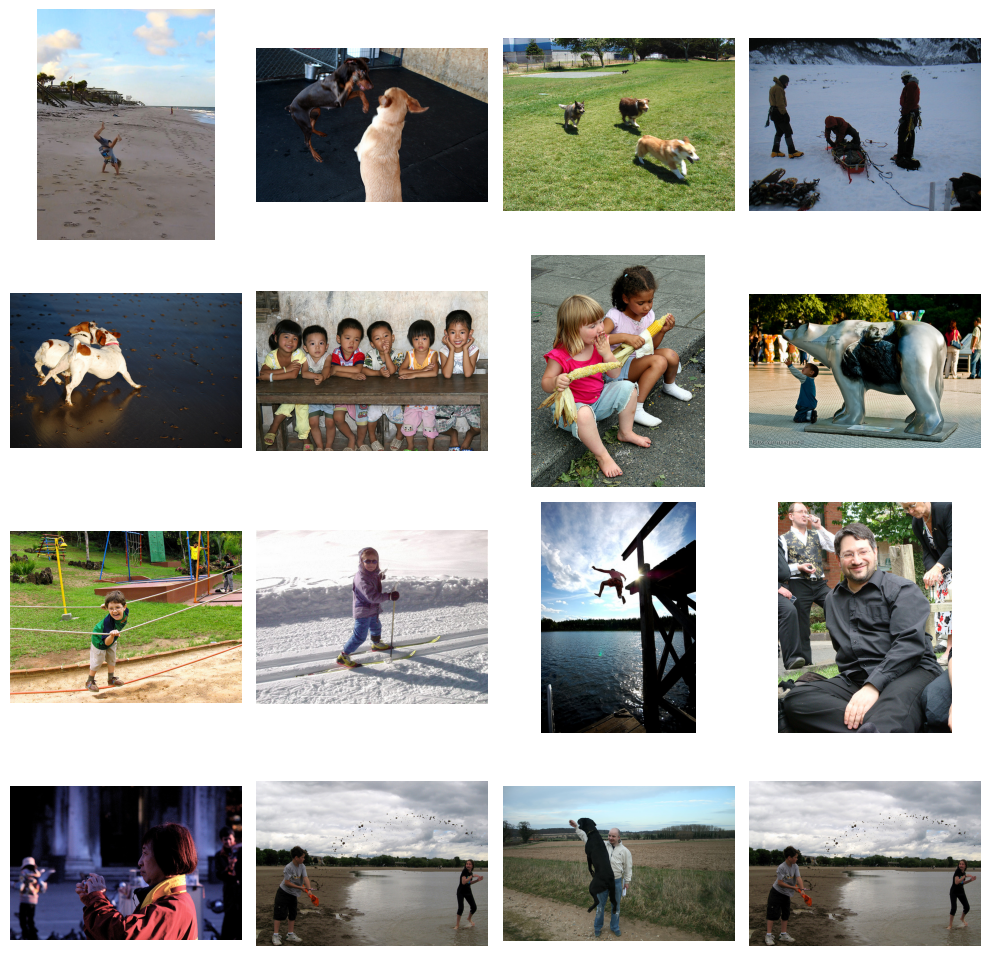

In [28]:

sirloin_images = list(train_dataset['image'].sample(8)) + list(test_queries['image'].sample(8))

fig, axes = plt.subplots(4, 4, figsize=(10, 10))

for i, ax in enumerate(axes.flat):
    image = Image.open(Path(PATH, 'train_images' if i < 8 else 'test_images', sirloin_images[i]))
    ax.imshow(image)
    ax.axis('off')
plt.tight_layout()

In [29]:
# Объединяем датасеты
merged_dataset = pd.merge(train_dataset,
                          aggregated_expert[['image', 'query_id', 'normalized_score']],
                          on=['image', 'query_id'],
                          how='left')

# Выводим первые несколько строк датасета
display(merged_dataset.head())

# Выводим информацию о размере датасета и пропущенных значениях
display(pd.DataFrame({
    'Размер объединенного датасета': [merged_dataset.shape],
    'Количество строк без экспертных оценок': [merged_dataset['normalized_score'].isnull().sum()]
}))

,image,query_id,query_text,normalized_score
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.000000
1,1262583859_653f1469a9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.000000
2,2447284966_d6bbdb4b6e.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.222222
3,2549968784_39bfbe44f9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,1.000000
4,2621415349_ef1a7e73be.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.000000


,Размер объединенного датасета,Количество строк без экспертных оценок
0,"(5822, 4)",0


<img src="https://upload.wikimedia.org/wikipedia/commons/b/ba/Warning_sign_4.0.png" align=left width=44, heigth=33>
<div class="alert alert-warning">
Не советую использовать метод print() для вывода таблиц, получается не очень красиво. В большинстве случаев можно вообще обойтись без команды, достаточно обратиться к таблице в последней строке ячейки. Или использовать команду display()
</div>

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
    <font size="3"><b>комментарий студента</b></font>
   
Спасибо за уточнение, мне нужно время что бы подпривыкнуть к этому. Я попробовала на этом куске кода, но дальше работу так не буду переписывать, учту на будущее при выполнении следущей работы.

</div>

In [30]:
# Удаляем строки без оценок
# merged_dataset_clean = merged_dataset.dropna(subset=['binary_score'])

# Проверяем результат
# print(f"Исходный размер датасета: {merged_dataset.shape}")
# print(f"Размер датасета после удаления строк без оценок: {merged_dataset_clean.shape}")


<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
да, теперь у нас есть датафрейм с основной обучающей информацией (признаки/тагет) </div>

In [31]:
train_dataset = merged_dataset

## Вывод по главе:


1) Сделали нужное нам окружение и импортировали библиотеки, которыми будем пользоваться
2) Данные представлены в нескольких файлах начнем по порядку
* 2.1 train_dataset содержит 5822 строк из которых у нас 1000 изображений , каждое изображение имеет в среднем до 5 описаний.

Мы визуализировали часто встречающиеся слова ( 20 популярных слов) в виде графика. Самые распространенные Собака и мужчина. Отмечу, что мы просто знакомились с данными, предобработка от детского контента не была выполнена на данном этапе.
* 2.2 test_queries содержит 500 строк из которых у нас уже 100 изображений и так же , какждое изображение в среднем имеет до 5 описаний.

Визуализацию данных не делала. Пропущенных значений нет.

* 2.3 CrowdAnnotations(crowd) файл с оценками от краудов, 97 % указывают на то что картинка не соответсвует действительности. Очень большой перекос в данных. В дальнейшем этот так или иначе повлияет на результаты модели.

* 2.4 ExpertAnnotations (expert) Мнение экспертов. У нас их трое , на данном этапе сделала предобработку и объеденила мнение всех трех экспертов в одно, там где были разногласия исключила из датасета эти строчки. В дальнейшем буду использовать мнение экспертов. Строит отметить , что  у экспертов больше диапозон соответсвия изображение-текст. Но нельзя исключать тот факт, что так же картинка-текст в большинстве случаев не соответсвует друг другу.

3) Вывели по 8 изображений из обучающих и тестовых данных . Изображение обширны от зверей-птиц до людей. Но на этой выборке , можно сделать вывод , что много детей до 16 лет. Предобработка не была еще сделана. Были отобраны слова так или иначе обозначающие ребенка.

<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
 👍 </div>

# 2. Проверка данных

В некоторых странах, где работает ваша компания, действуют ограничения по обработке изображений: поисковым сервисам и сервисам, предоставляющим возможность поиска, запрещено без разрешения родителей или законных представителей предоставлять любую информацию, в том числе, но не исключительно тексты, изображения, видео и аудио, содержащие описание, изображение или запись голоса детей. Ребёнком считается любой человек, не достигший 16 лет.

В вашем сервисе строго следуют законам стран, в которых работают. Поэтому при попытке посмотреть изображения, запрещённые законодательством, вместо картинок показывается дисклеймер:

⎪ This image is unavailable in your country in compliance with local laws
Однако у вас в PoC нет возможности воспользоваться данным функционалом. Поэтому все изображения, которые нарушают данный закон, нужно удалить из обучающей выборки.

In [32]:
lemmatize = nltk.WordNetLemmatizer()

def get_lemmas(text) -> list:


    text = re.sub('[^a-zA-Z]', ' ', text).lower() # удаляем неалфавитные символы, приводим к нижнему регистру
    text = nltk.word_tokenize(text, language = 'english') # токенизируем слова
    text = [lemmatize.lemmatize(word) for word in text] # лемматирзируем слова

    return text

def cleaning(row) -> object:


    text = get_lemmas(row['query_text'])
    if [i for i in text if i in BLOCK]:
        row['to_block'] = 1
    else:
        row['to_block'] = 0

    return row

In [33]:
train_dataset = train_dataset.apply(cleaning, axis=1)

<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
Идея с лемматизацией хороша. Но она очень "дорогая" - хорошая лемматизация занимает время. Кроме того ведь её нужно написать, проверить на ошибки, возможно "утащить в прод"..
    
А между тем лемматизация  нужна нам в двух случаях:  

 - При чистке датасета от детских изображений. 
 - При векторизации.
    
При поиске детских изображений я  считаю возможным упростить себе жизнь - взять возможные словоформы "запрещенных" слов. Как правиль их всего две - единственное и множественное число. 
    
А для векторизациии делать лемматизацию в нашем случае не нужно. Модель BERT обучалась на обычных, сырых,не лемматизированных текстах.    

    
</div>

In [34]:
train_dataset.head(10)

,image,query_id,query_text,normalized_score,to_block
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.000000,1
1,1262583859_653f1469a9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.000000,1
2,2447284966_d6bbdb4b6e.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.222222,1
3,2549968784_39bfbe44f9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,1.000000,1
4,2621415349_ef1a7e73be.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.000000,1
5,3030566410_393c36a6c5.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.444444,1
6,3155451946_c0862c70cb.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.000000,1
7,3222041930_f642f49d28.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.000000,1
8,343218198_1ca90e0734.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.000000,1
9,3718964174_cb2dc1615e.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...,0.000000,1


In [35]:
  # Выводим распределение бинарных оценок
binary_blok = train_dataset['to_block'].value_counts().sort_index()
print("\nРаспределение бинарных оценок:")
print(binary_blok.to_string())


Распределение бинарных оценок:
0    4175
1    1647


In [36]:
print(train_dataset[train_dataset['to_block'] == 1]['query_text'].sample(16).unique())

['A young boy wearing a light blue jacket walks across the brick patio .'
 'The girls were in the crowd .'
 'Two woman in colorful costumes look at a little girl wearing a brown vest .'
 'A young girl standing in front of a fountain'
 'The person in the yellow shirt is sitting with a child at a wooden picnic table .'
 'A child in a white shirt coming out of a swing in midair .'
 'A young child is riding a purple bike .'
 'A little boy is running towards a group of people .'
 'A young woman watches as a young blond boy swings in a chair swing with buildings visible in the background .'
 'A young , long-haired , girl on the beach , is jumping in the air .'
 'People are gathered around watching children with a pig .'
 'A young , fit man wearing short does a high right kick in the air .'
 'Two boys on ice skates race on an outdoor ice rink .'
 'A toddler in a red jacket is balancing on top of snow .'
 'a young girl wearing blue smiles .'
 'A little girl with a yellow dress blows the whistl

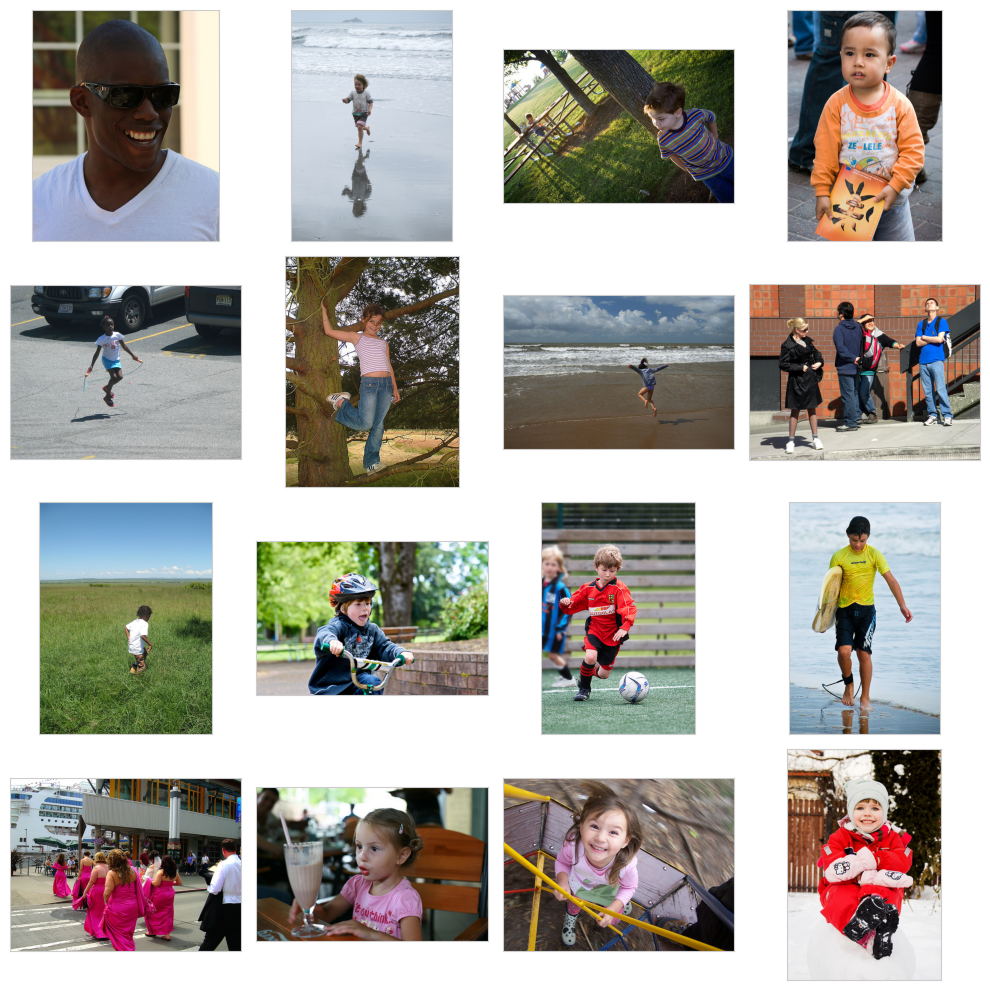

In [37]:
samples = list(train_dataset[train_dataset['to_block'] == 1]['query_id'].sample(20))
samples = [i[:-2] for i in samples]

fig = plt.figure(figsize=(10,10))
for i in range(16):
    fig.add_subplot(4, 4, i+1)
    image = Image.open(Path(PATH, 'train_images', samples[i]))
    plt.imshow(image)
    plt.xticks([])
    plt.yticks([])
    plt.tight_layout()

Исходя из полученной информации и визуализации данных, наш словарь, оказался верным. Следуюший этап мы создадим новую переменную для удобства и безопасности. Там же произведем удаление строк, а их у нас 1605 с запрещенными изображениям.

In [38]:
#Извлечение имен плохих изображений
bad_images = train_dataset[train_dataset['to_block'] == 1]['query_id'].str[:-2]#.unique()

#Удаление всех записей, связанных с плохими изображениями
train_ds = train_dataset[~train_dataset['image'].isin(bad_images)]


#Дополнительная проверка и удаление оставшихся заблокированных текстов 
#train_ds = train_ds[train_ds['to_block'] == 0]

# Сбрасываем индекс
train_ds = train_ds.reset_index(drop=True)

# Проверка результатов
print(f"Исходный размер датасета: {len(train_dataset)}")
print(f"Размер очищенного датасета: {len(train_ds)}")
print(f"Количество удаленных записей: {len(train_dataset) - len(train_ds)}")

Исходный размер датасета: 5822
Размер очищенного датасета: 3998
Количество удаленных записей: 1824


In [39]:
def count_high_score_blocked(train_ds):
    # Вычисляем 75% квантиль для normalized_score
    quantile_75 = train_ds['normalized_score'].quantile(0.75)
    
    # Создаем маску для строк, где normalized_score больше 75% квантиля и to_block равен 1
    mask = (train_ds['normalized_score'] > quantile_75) & (train_ds['to_block'] == 1)
    
    # Подсчитываем количество строк, удовлетворяющих условию
    count = mask.sum()
    
    # Вычисляем процент от общего количества строк
    percentage = (count / len(train_ds)) * 100
    
    print(f"Количество строк, где normalized_score > {quantile_75:.2f} (75% квантиль) и to_block == 1: {count}")
    print(f"Это составляет {percentage:.2f}% от общего количества строк.")
    
    return count

# Использование функции
result = count_high_score_blocked(train_ds)

Количество строк, где normalized_score > 0.33 (75% квантиль) и to_block == 1: 57
Это составляет 1.43% от общего количества строк.


Решила перепроверить, так как и в последующем вылетали изображения с детьми.

In [40]:

train_ds = train_ds[~((train_ds['normalized_score'] > train_ds['normalized_score'].quantile(0.75))
                      & (train_ds['to_block'] == 1))].reset_index(drop=True)

In [41]:

# Удаляем строки, где to_block равно 1
#train_ds = train_dataset[train_dataset['to_block'] == 0]

# Сбрасываем индекс
#train_ds = train_ds.reset_index(drop=True)


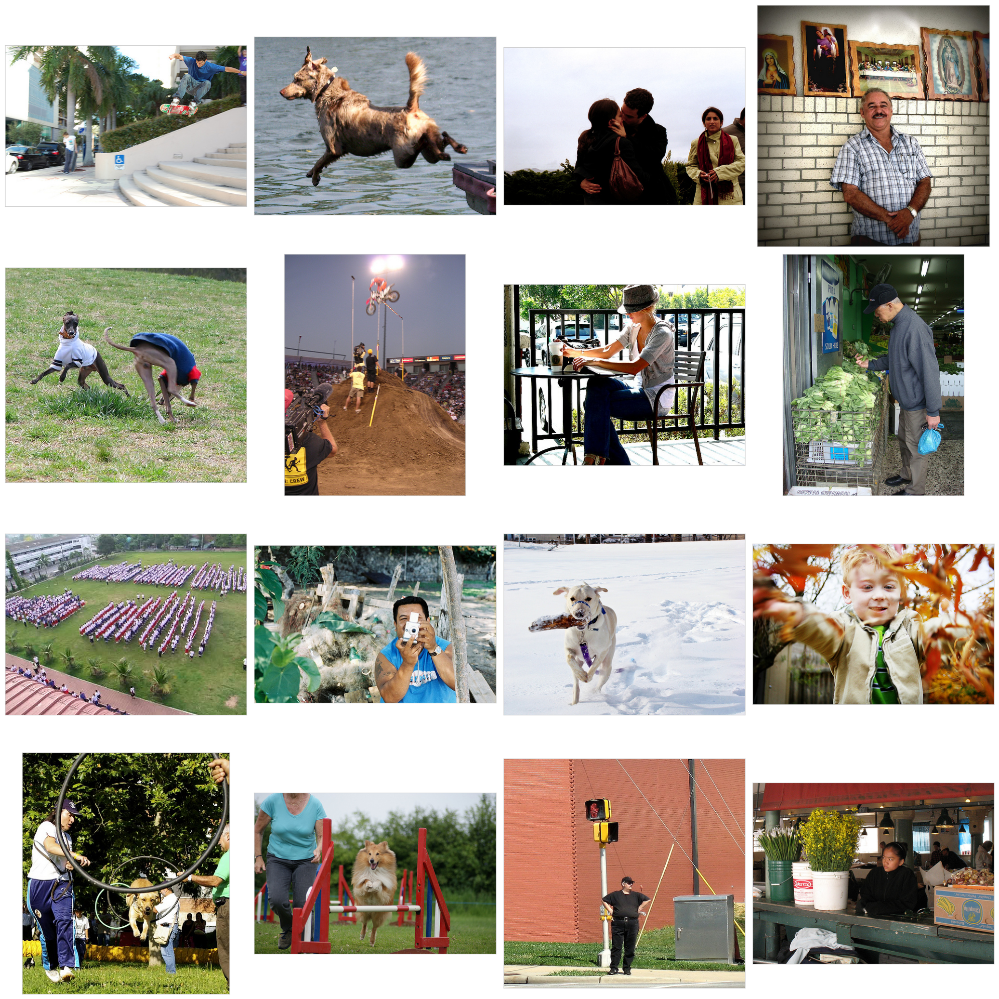

Всего изображений с to_block = 1: 886


In [42]:
import random

# Выбираем все изображения, где to_block = 1
blocked_images = train_ds[train_ds['to_block'] == 1]['image'].tolist()

# Случайно выбираем 16 изображений
samples = random.sample(blocked_images, 16)

fig = plt.figure(figsize=(20,20))
for i, sample in enumerate(samples, 1):
    ax = fig.add_subplot(4, 4, i)
    
    # Открываем изображение
    image_path = Path(PATH, 'train_images', sample)
    image = Image.open(image_path)
    
    # Отображаем изображение
    ax.imshow(image)
    ax.set_xticks([])
    ax.set_yticks([])
    
    # Получаем соответствующую строку из датасета
    row = train_ds[train_ds['image'] == sample].iloc[0]

plt.tight_layout()
plt.show()

# Выводим количество изображений с to_block = 1
print(f"Всего изображений с to_block = 1: {len(blocked_images)}")

<img src="https://upload.wikimedia.org/wikipedia/commons/thumb/8/81/Stop_sign.png/240px-Stop_sign.png" align=left width=35, heigth=35>
<div class="alert alert-danger">
    
К сожалению эту ошибку я очень хорошо знаю, она кочует между студенческих работ с тех пор, как два года назад я не заметил у студента одной из первых когорт.
    
   
          
Ты удаляешь комментарии, в которых были запрещенные слова. Но наша задача убрать изображения, содержащие детей. Есть два способа сделать это:
    
 - Определить список плохих изображений, как изображения удовлетворяющие условиям:
    - Комментарий содержит плохие слова
    - <b>Оценка соответствия комментария и изображения выше порога.</b>
 - Удалить из нашего датасета все пары "изображение/описание" с плохими изображениями.
    
 
И второй, очень красивый способ. Он основан на том, что `query_id` содержит в с себе имя изображения, для которого он был написан (такая пасхалочка от авторов датасета).
    
 - Определить список плохих комментариев
 - У `query_id`  плохих комментариев отрезать два последних символа и получим список плохих изображений.
    
    
Самое обидное, что ты совершенно верно определила список фото с детьми и показала их, но удаляешь записи ты по признаку "в описании есть упоминание детей".    
    
    
</div>

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
    <font size="3"><b>образец комментария студента</b></font>
   
Я почистила данные, но после очистки у меня еще оставались описания с блокирующими словами, но для доп проверки я посмотрела по квантилю сколько строк еще лишних и удалила их.

</div>

In [43]:
train_ds = train_ds.drop(['to_block'],axis = 1)

## Вывод по главе:
1) Произвели лиматизацию текста , для поиска блокирующих слов.
2) В нашем датасете 1605 строк содержат стоп слова .  Сделали визуализацию данныз с помошью вывода текста и самих изображений. Убедились, что все сзодится и удалили блокирующие изображение=текст.
3) Единственное и самое важное, мы вели поиск по описанию, но в большинтсве т.е больше 50 процентов картинка не соответсвует тексту по мнению выбранных экспертов!


## 3. Векторизация изображений

In [44]:
def load_img(path=PATH, train=True) -> ImageDataGenerator:
    datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

    generator = datagen.flow_from_dataframe(
        dataframe=train_ds if train else test_images,
        directory=Path(path, 'train_images' if train else 'test_images'),
        x_col='image',
        y_col='normalized_score' if train else None,
        target_size=(224, 224),
        batch_size=16,
        class_mode='raw' if train else None,
        shuffle=False,
        seed=SEED)

    return generator

In [45]:
#def load_img(path=PATH, train=True) -> ImageDataGenerator:
#    datagen = ImageDataGenerator(rescale=1/255.)

#    generator = datagen.flow_from_dataframe(
#        dataframe=train_ds if train else test_images,
#        directory=Path(path, 'train_images' if train else 'test_images'),
#        x_col='image',
#        y_col='binary_score' if train else None,
#        target_size=(224, 224),
#        batch_size=16,
#        class_mode='raw' if train else None,
#        shuffle=False,
#        seed=SEED)

#    return generator

<img src="https://upload.wikimedia.org/wikipedia/commons/b/ba/Warning_sign_4.0.png" align=left width=44, heigth=33>
<div class="alert alert-warning">
Чтобы эмбеддинги  были качественными, стоит использовать специальную предобработку, повторяющую условия, при которых модель обучалась. 
    
В разделе "компьютерное зрение с pytorch" приведен образец кода, как проводить эту предобработку при использовани моделей pytorch.
    
В случае Keras нужно использовать специальную фукнцию preprocess_input
    
    from keras.applications.resnet50 import preprocess_input
    ...
    train_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)
    
--------------
    
Важно: препроцессинг в данном случае отменяет необходимость делай рескейл. Т.е. `preprocessing_function` мы указываем вместо `rescale`.    
    
</div>

Выжные замечания:
1) shuffle=False что бы данные не перемешивались , у нас же основания задача сопоставления.
2) class_mode='raw' дает больше гибкости при обработке текстовых описаний.

In [46]:
flo_train = load_img()
features, target = next(flo_train)

Found 3941 validated image filenames.


Так как мы будем использовать модель ResNet-50, мы должны исключить полносвязные слои, которые отвечают за конечное предсказание.

In [47]:
def create_model(input_shape= (224, 224, 3)):

    backbone = ResNet50(input_shape=input_shape,
                weights='imagenet',
                include_top=False)

    model = Sequential([
        backbone,
        GlobalAveragePooling2D()
    ])

    #optimizer = Adam(learning_rate=0.0001)
    optimizer = tf.keras.optimizers.AdamW(learning_rate=1e-4, weight_decay=1e-5)

    model.compile(loss='mean_squared_error', optimizer=optimizer, metrics=['mae'])

    return model

In [48]:
def vector_images(model, train_ds):
    predictions = model.predict(train_ds)
    return predictions

In [49]:
embeding_foto = vector_images(create_model(),load_img())
embeding_foto.shape

Found 3941 validated image filenames.


/home/anna/.local/lib/python3.9/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


247/247 ━━━━━━━━━━━━━━━━━━━━ 449s 2s/step


(3941, 2048)

<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
 Отлично, вектра для изображений получены👍 </div>

## 4.Векторизация текстов

у меня был выбор между Word2Vec и BERT посмотрим краткую выжемку.

1 Word2Vec:
 1 Учитывает семантику слов
 2 Фиксированный размер вектора для каждого слова
 3 Не зависит от контекста предложения

 2 BERT:(Выбрали именно этоt)
 1 Учитывает контекст всего предложения
 2 Дает более глубокое понимание семантики
 3 Требует больше вычислительных ресурсов( поэтому батчи ставим)

<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
Правильный выбор. На самом деле сейчас для эмбеддингов BERT является индустриальным стандартом, т.к. он создает эмбеддинг текста с учетом контекста и их взаимного предопложения.  А в случае word2vec нам бы потребовалось рассчитать эмбеддинг описания как среднее эмбедингов всех слов, входящих в описание.</div>

In [50]:
# Загрузка модели и препроцессора
bert = keras_nlp.models.BertBackbone.from_preset('bert_base_en')
preprocessor = keras_nlp.models.BertPreprocessor.from_preset('bert_base_en')

In [51]:
def vectorize_text(texts, batch_size=32, show_progress=True, verbose=0):
    tokenized = preprocessor(texts)
    num_batches = len(texts) // batch_size + (1 if len(texts) % batch_size != 0 else 0)

    embeddings = []

    iterator = range(num_batches)

    if show_progress:
        iterator = tqdm(iterator, desc="Processing text batches")

    for i in iterator:
        start = i * batch_size
        end = min((i + 1) * batch_size, len(texts))

        batch = {
            'token_ids': tokenized['token_ids'][start:end],
            'segment_ids': tokenized['segment_ids'][start:end],
            'padding_mask': tokenized['padding_mask'][start:end]
        }

        batch_embeddings = bert(batch, training=False)['pooled_output']
        embeddings.append(batch_embeddings)

        if verbose > 0 and i % verbose == 0:
            print(f"Processed {i * batch_size} texts")

    return tf.concat(embeddings, axis=0)

# Пример использования
text_vectors = vectorize_text(train_ds['query_text'].tolist())


Processing text batches:   0%|          | 0/124 [00:00<?, ?it/s]

In [52]:
text_vectors.shape

TensorShape([3941, 768])

<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
Отлично,полученные векторные представления для текстов описаний с помощью BERT </div>

## Вывод по главе
Произвели векторизации текста с помощью BERT, так как она больше адаптированна под нашу задачу.


## 5. Объединение векторов

In [53]:
features = np.concatenate((embeding_foto, text_vectors), axis=1)
features.shape

(3941, 2816)

In [54]:
target = np.array(train_ds['normalized_score'])
target.shape

(3941,)

<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
 Вектора, полученные из текста и изображения объеденены👍 </div>

## Вывод по главе
Произвели объединение эмбедингов и вывод целефой метрики.

## 6. Обучение модели предсказания соответствия

Для обучения разделите датасет на тренировочную и тестовую выборки.

Простое случайное разбиение не подходит: нужно исключить попадание изображения и в обучающую, и в тестовую выборки.

Для того чтобы учесть изображения при разбиении, воспользуемся классом GroupShuffleSplit из библиотеки sklearn.model_selection.

In [55]:
groups = train_ds['image']
gss = GroupShuffleSplit(n_splits=1, train_size=.7, random_state=SEED)

train_indices, valid_indices = next(gss.split(X=features, y=target, groups=groups))



<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
Отлично, благодаря использованию GroupShuffleSplit ты исключаешь попадание одного изображения в обучающий и валидационный наборы.</div>

<img src="https://upload.wikimedia.org/wikipedia/commons/b/ba/Warning_sign_4.0.png" align=left width=44, heigth=33>
<div class="alert alert-warning">
Только давай разберемся с выборками. Финальное тестирование (визуальное) мы делаем на отложенной выборке. Поэтому выборка,которую ты сейчас отделил играет роль валидационной. Есть смысл в её названии использовать слово valid а не test</div>

In [56]:
features_train, features_valid = features[train_indices], features[valid_indices]


In [57]:
target_train, target_valid = target[train_indices], target[valid_indices]

In [58]:
scaler = StandardScaler()
scaler.fit(features_train)

StandardScaler()

In [59]:
features_train = scaler.transform(features_train)
features_valid = scaler.transform(features_valid)

<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
 👍 </div>

 1 Чувствительность к важным ошибкам: RMSE придает больший вес крупным ошибкам, возводя их в квадрат. В Hашем случае, когда речь идет о оценке соответствия изображений и описаний, крупные ошибки могут быть особенно важны, так как они указывают на серьезные несоответствия.

 2 Та же единица измерения: RMSE выражается в тех же единицах, что и Hаши оценки экспертов. Это делает результаты более понятными и легкими для интерпретации, что важно при презентации PoC руководству.

 3 Баланс между точностью и интерпретируемостью: RMSE обеспечивает хороший баланс между точностью оценки ошибки и простотой понимания результатов.

Почему не стоит выбирать MAPE:
 1 Проблемы с нулевыми значениями: MAPE может давать бесконечные или неопределенные результаты, когда фактические значения близки к нулю или равны ему. В Hашем случае, если есть оценки экспертов близкие к нулю, это может привести к искажению результатов.

 2 Несимметричность ошибок: MAPE трактует положительные и отрицательные ошибки по-разному, что может привести к несбалансированной оценке производительности модели.

 3 Чувствительность к выбросам: MAPE может быть чрезмерно чувствительна к выбросам, особенно когда фактические значения малы, что может исказить общую картину производительности модели.



Модели на работу
1. RandomForestRegressor для базовой линии
2. Линейную регрессию;
3. Полносвязные нейронные сети. NN

<img src="https://upload.wikimedia.org/wikipedia/commons/b/ba/Warning_sign_4.0.png" align=left width=44, heigth=33>
<div class="alert alert-warning">
Мы решаем новую задачу и не знаем, наксколько хороши наши метрики и наши модели. Поэтому советую начать с бейзлайна - константной модели (можешь взять простой DummyRegressor).</div>

In [60]:
features_train.shape

(2772, 2816)

Добавила бейзлайн 

In [61]:
%%time
model_rf = DummyRegressor().fit(features_train, target_train)
predictions = model_rf.predict(features_train)
np.sqrt(np.sqrt(mean_squared_error(target_train, predictions)))

CPU times: user 2.44 ms, sys: 0 ns, total: 2.44 ms
Wall time: 2.15 ms


0.5314828122789784

In [62]:
%%time
model_rf = RandomForestRegressor().fit(features_train, target_train)
predictions = model_rf.predict(features_train)
np.sqrt(np.sqrt(mean_squared_error(target_train, predictions)))

CPU times: user 12min 39s, sys: 75 ms, total: 12min 40s
Wall time: 12min 41s


0.3059950753002891

Линейную регрессию;

In [63]:
%%time
# Линейная регрессия

model_lr = LinearRegression().fit(features_train, target_train)
predictions = model_lr.predict(features_train)
np.sqrt(np.sqrt(mean_squared_error(target_train, predictions)))

CPU times: user 19.6 s, sys: 1.37 s, total: 21 s
Wall time: 5.49 s


0.4190910592490723

In [64]:
model_nn = Sequential([
    Dense(512, activation=tf.keras.layers.LeakyReLU(alpha=0.01), input_shape=(2816,), kernel_regularizer=l2(1e-4)),
    BatchNormalization(),
    Dropout(0.3),
    Dense(256, activation=tf.keras.layers.LeakyReLU(alpha=0.01), kernel_regularizer=l2(1e-4)),
    BatchNormalization(),
    Dropout(0.3),
    Dense(128, activation=tf.keras.layers.LeakyReLU(alpha=0.01), kernel_regularizer=l2(1e-4)),
    BatchNormalization(),
    Dropout(0.3),
    Dense(64, activation=tf.keras.layers.LeakyReLU(alpha=0.01), kernel_regularizer=l2(1e-4)),
    Dense(1, activation='sigmoid')
])

optimizer = AdamW(learning_rate=1e-4, weight_decay=1e-4)
model_nn.compile(optimizer=optimizer, loss='mean_squared_error', metrics=[tf.keras.metrics.RootMeanSquaredError()])

early_stopping = tf.keras.callbacks.EarlyStopping(patience=15, restore_best_weights=True)



/home/anna/.local/lib/python3.9/site-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(
/home/anna/.local/lib/python3.9/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [65]:
history = model_nn.fit(
    features_train, target_train,
    validation_data=(features_valid, target_valid),
    epochs=15,
    batch_size=32,
    shuffle=True,
    callbacks=[early_stopping],
    verbose=2
)

Epoch 1/15
87/87 - 6s - 74ms/step - loss: 0.3065 - root_mean_squared_error: 0.4001 - val_loss: 0.2559 - val_root_mean_squared_error: 0.3310
Epoch 2/15
87/87 - 3s - 35ms/step - loss: 0.2509 - root_mean_squared_error: 0.3235 - val_loss: 0.2248 - val_root_mean_squared_error: 0.2804
Epoch 3/15
87/87 - 3s - 35ms/step - loss: 0.2268 - root_mean_squared_error: 0.2840 - val_loss: 0.2216 - val_root_mean_squared_error: 0.2750
Epoch 4/15
87/87 - 3s - 35ms/step - loss: 0.2175 - root_mean_squared_error: 0.2676 - val_loss: 0.2205 - val_root_mean_squared_error: 0.2734
Epoch 5/15
87/87 - 3s - 35ms/step - loss: 0.2097 - root_mean_squared_error: 0.2531 - val_loss: 0.2187 - val_root_mean_squared_error: 0.2705
Epoch 6/15
87/87 - 3s - 35ms/step - loss: 0.2079 - root_mean_squared_error: 0.2499 - val_loss: 0.2179 - val_root_mean_squared_error: 0.2694
Epoch 7/15
87/87 - 3s - 35ms/step - loss: 0.2048 - root_mean_squared_error: 0.2441 - val_loss: 0.2162 - val_root_mean_squared_error: 0.2668
Epoch 8/15
87/87 - 3

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
    <font size="3"><b>комментарий студента</b></font>
   

Это не первая версия архитектуры, я уже пробовала и другие у меня не было изночально L2 регуляризации, она появилась лишь в последней моей версии, так же смотрела разное количество слоев и разную активацию. Кол-во эпох так же было разное, на каком то этапе я просто сделала стоп кран. Данный блок прорабатывала дольше всего, что бы добиться адекватных метрик и убрать сильное расхждение между обучением и валидацией.

<img src="https://upload.wikimedia.org/wikipedia/commons/b/ba/Warning_sign_4.0.png" align=left width=44, heigth=33>
<div class="alert alert-warning">
На мой взгляд ты воспринимаешь "количество эпох" как гиперпараметр "спущеный с верху". Т.е. устанавливаем параметры сети, запускаем обучение и смотрим на результат.
    
Но в случае с нейронками логика ипользования немного отличается от того, к чему мы привыкли в классических моделях. Здесь лучше работать по другой логике:
    
 - оределилили архитектуру, создали модель
 - начинаем её учить. и учим пока метрика на валидационной выборке улучшается.  Наблюдая в динамике метрики на обучающей и валидационной выборках.
 - если вдруг метрика на обучающей выборке перестала снижаться, можно попробовать уменьшить шаг обучения (например в 10 раз) и продолжить обучение модели.
    
В любом случае полезно обучать модель пока метрика на валидации улучшается. Наша цель - оптимальное состояние модели, при котором модель хорошо находит законмоерности в данных, но еще не переобучилась.
        
После того, как закончили обучение смотрим на логи, анализируем, чего модели не хватило, меняем архитектуру и запускаем обучение по новой.    
    

    

    
</div>

<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">


Для осознанной настройки нейронки важно понимать, как менять её архитектуру (усложнять и уменьшать регуляризацию? уменьшать шаг обучения? усиливать регуляризацию?). Для того чтобы принять эти  решения мало видеть только конечную цифру, важно понимать, чего модели не хватает чтобы метрика стала лучше.
    
    
Вот типичные  проблемы, которые можно выявить  анализируя графики и пути их решения:

<b>Недообучение (Underfitting)</b>
  Признаки: Высокие значения потерь и низкая точность как на обучающей, так и на валидационной выборке. Графики потерь не снижаются (или снижаются  недостаточно).
  
  Решения:
    
 - Увеличение сложности модели (добавление слоев, увеличение числа нейронов).
 - Использование более сложных моделей, таких как более глубокие нейронные сети.
 - Увеличение количества эпох обучения.

<b>Переобучение (Overfitting)</b>
  Признаки: Значительное снижение потерь и увеличение точности на обучающей выборке, но высокие потери и низкая точность на валидационной выборке. Графики начинают расходиться после некоторого количества эпох.
    
 Решения:
  - Регуляризация (L1, L2 регуляризация).
  - Dropout (добавление Dropout слоев).
  - Уменьшение сложности модели (уменьшение числа слоев или нейронов).
  - Использование аугментации данных для увеличения разнообразия данных.
  - Раннее завершение обучения (Early Stopping) на основе валидационной ошибки.

<b>Плохой выбор гиперпараметров</b>
 Признаки: Нестабильные графики потерь и точности (большие колебания).
 
 Решения:
  - Настройка скорости обучения (learning rate).
  - Оптимизация размера батча (batch size).
  - Попробовать другие оптимизаторы (например, Adam, SGD с различными параметрами).    

</div>

## 7. Тестирование модели

In [66]:
embeding_test = vector_images(create_model(),load_img(train=False))
embeding_test.shape

Found 100 validated image filenames.


/home/anna/.local/lib/python3.9/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


7/7 ━━━━━━━━━━━━━━━━━━━━ 13s 2s/step


(100, 2048)

<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
Отлично, вектора для тестовых изображений получены</div>

In [67]:
def get_picture(text) -> None:

    if [i for i in get_lemmas(text) if i in BLOCK]: #проверяем не нужно ли вывести на экран заглушку
        print('')
        print('-' * 20, text, '-' * 20)
        print('')
        print('This image is unavailable in your country in compliance with local laws.')
        print('')
    else:
        text_embed = vectorize_text([text], show_progress=False)
 #получаем эмбеддинг текста
        X = np.concatenate(( #объединяем вектора тестовых картинок с эмбеддингом текста
            embeding_test,
            np.resize(text_embed, (embeding_test.shape[0],768))),
            axis=1)
        X = scaler.transform(X)
        predictions = model_nn.predict(X) #получаем предсказания оценок экспертов
        df = pd.concat((test_images, pd.Series(np.reshape(predictions, (predictions.shape[0],)), name='pred')), axis=1) #добавляем оценки к номерам картинок
        top = list(df.sort_values(by='pred', ascending=False)['image'].head(5)) #получили топ 5 имён файлов с картинками
        top_score = list(df.sort_values(by='pred', ascending=False)['pred'].head(5)) #получили топ 5 оценок

        print('')
        print('-' * 20, text, '-' * 20)
        print('')

        fig = plt.figure(figsize=(15,5)) #выводим на экран 5 наиболее похожих картинок
        plt.rcParams['axes.edgecolor'] = 'black'
        plt.rcParams['axes.linewidth'] = 0
        for i in range(5):
            fig.add_subplot(1, 6, i+1, title=round(top_score[i], 2))
            image = Image.open(Path(PATH, 'test_images', top[i]))
            plt.imshow(image)
            plt.xticks([])
            plt.yticks([])
            plt.tight_layout()

        if text in list(test_queries['query_text']): #если текст был в исходном файле с описаниями - добавляем оригинальную картинку
            plt.rcParams['axes.edgecolor'] = 'green'
            plt.rcParams['axes.linewidth'] = 5
            fig.add_subplot(1, 6, 6)
            image = Image.open(Path(PATH, 'test_images', test_queries.iloc[test_queries[test_queries['query_text'] == text].index[0]]['image']))
            plt.imshow(image)
            plt.xticks([])
            plt.yticks([])
            plt.tight_layout()

        plt.show()

    return None


-------------------- A woman and a younger girl , both wearing blue jackets and knit caps , slide down a hill on a snow sled , a dog running at their side . --------------------

This image is unavailable in your country in compliance with local laws.

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step

-------------------- A man is operating a television camera high up in a crowded stadium . --------------------



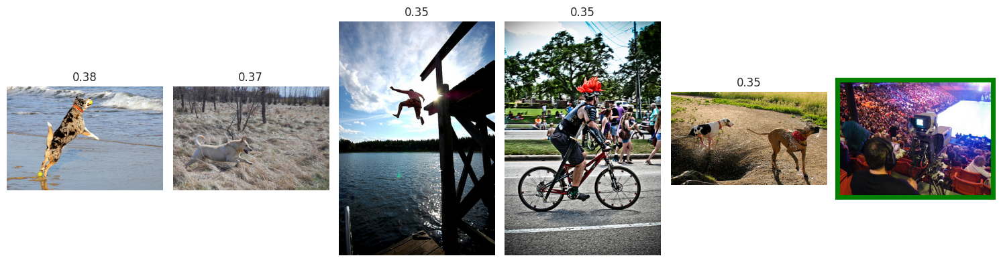

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 

-------------------- People are watching a race car speed thorugh the dirt . --------------------



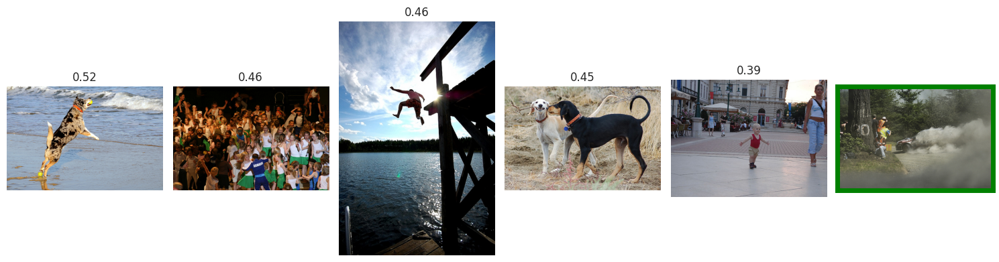


-------------------- a woman dumping water on a small child who is in a pool --------------------

This image is unavailable in your country in compliance with local laws.

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 

-------------------- The man with the white head piece looks left down the street . --------------------



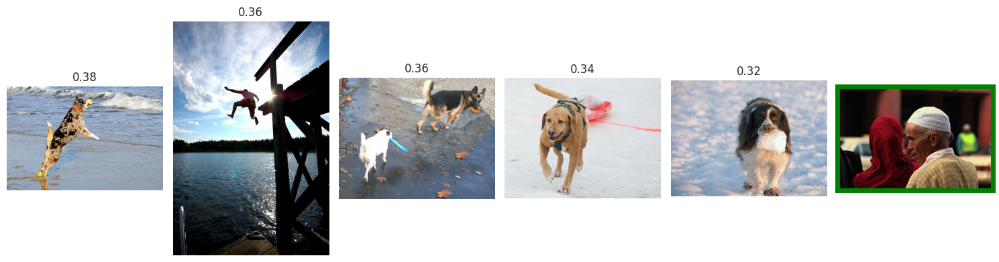


-------------------- Boy flings mud at girl --------------------

This image is unavailable in your country in compliance with local laws.

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 

-------------------- A shirtless male looks to his right while water flows over him . --------------------



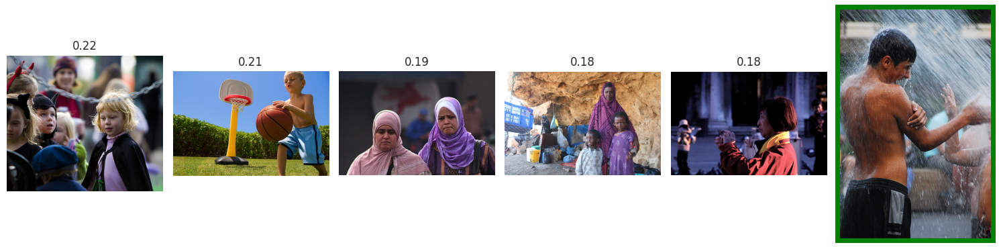

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 

-------------------- a large man dozes off on the bus . --------------------



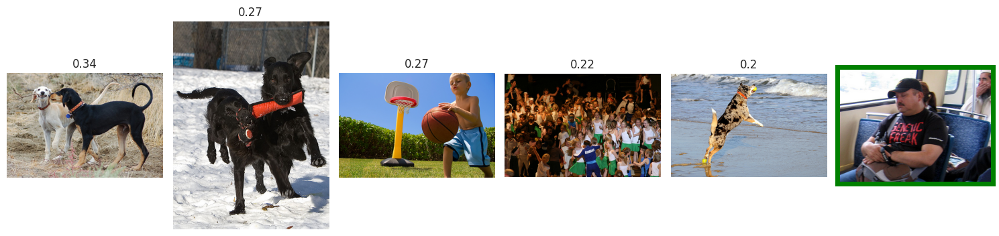

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 

-------------------- The heavy man is sitting on a bus and sleeping . --------------------



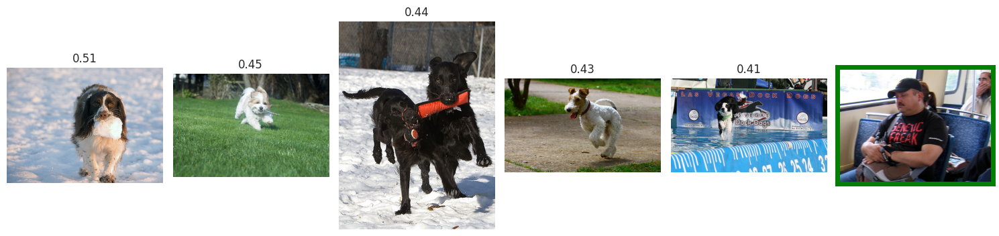


-------------------- Three boys are standing in a row along an upraised wall and rail , each a level higher than the one before . --------------------

This image is unavailable in your country in compliance with local laws.



In [68]:
test_phrases = list(test_queries['query_text'].sample(10))

for phrase in test_phrases:
    get_picture(phrase)

<img src="https://emojigraph.org/media/apple/check-mark-button_2705.png" align=left width=33, heigth=33>
<div class="alert alert-success">
Функции написаны и со своей задачей справляются. Принимают на вход текст и находят изображение. Отрабатывают контроль "запрещенного контента".

Да,  сожалению работают они не очень. Причин несколько
    
 - Предобработка изображений. Посмотри как готовились изображения в образце кода, который был дан в теории к спринту применительно к pytorch.  Лучше предобработка - выше качество эмбеддингов.
 - Не стоит делать бинаризацию таргета, моделям сложнее учиться.
 - Возможно нейронка просто недообучена. Задача очень сложная и нетривиальная, за 15 эпох она точно не сможет выявить все закономерности.
    
----------------
    
Как правило хороший результат в этом проекте удается достичь при выполнении следующих условий
    
 - использование экспертных оценок   
 - векторизация изображений через pytorch, как есть в теории к спринту  (но с отрезанием только одного слоя)
 - эмбеддинги через bert
 - упорное обучение нейронки (иногда тысячи эпох, в любом случае пока лосс снижается) с тщательным подбором гиперпараметров.   
    
</div>

In [69]:
test_phrases

['A woman and a younger girl , both wearing blue jackets and knit caps , slide down a hill on a snow sled , a dog running at their side .',
 'A man is operating a television camera high up in a crowded stadium .',
 'People are watching a race car speed thorugh the dirt .',
 'a woman dumping water on a small child who is in a pool',
 'The man with the white head piece looks left down the street .',
 'Boy flings mud at girl',
 'A shirtless male looks to his right while water flows over him .',
 'a large man dozes off on the bus .',
 'The heavy man is sitting on a bus and sleeping .',
 'Three boys are standing in a row along an upraised wall and rail , each a level higher than the one before .']

In [70]:
queries= ['Two dogs are wrestling in the park',
            'A black dog jumps up to a man uplifted hand',
            'A camera man is behind his video camera and surrounded by a hudge crowd ',
            'A white dog and a black dog in a field',
            'Two men are standing under what looks to be a giant robot'
           ]

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 

-------------------- Two dogs are wrestling in the park --------------------



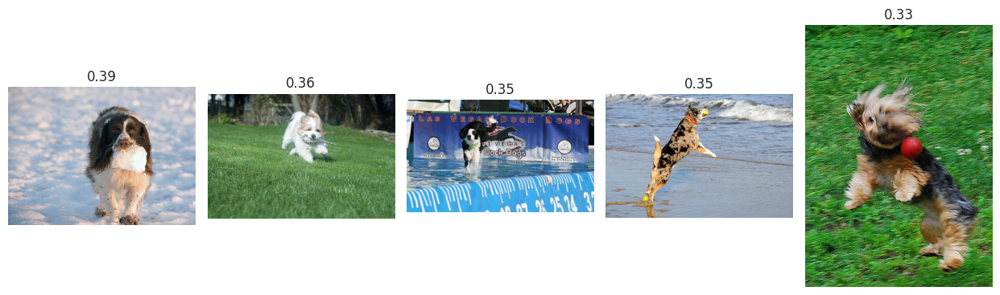

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 

-------------------- A black dog jumps up to a man uplifted hand --------------------



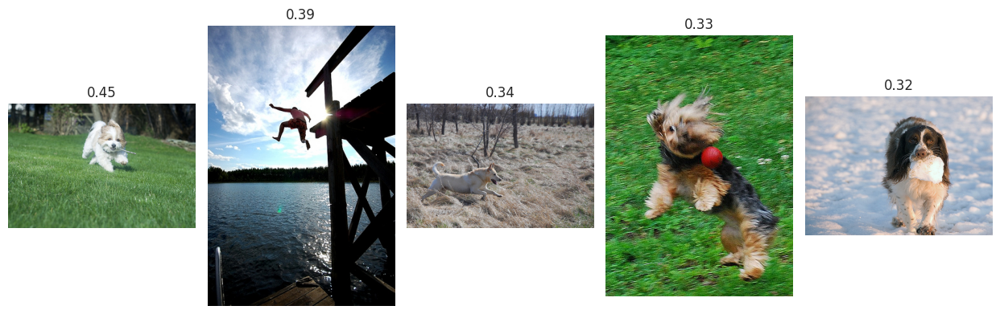

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 

-------------------- A camera man is behind his video camera and surrounded by a hudge crowd  --------------------



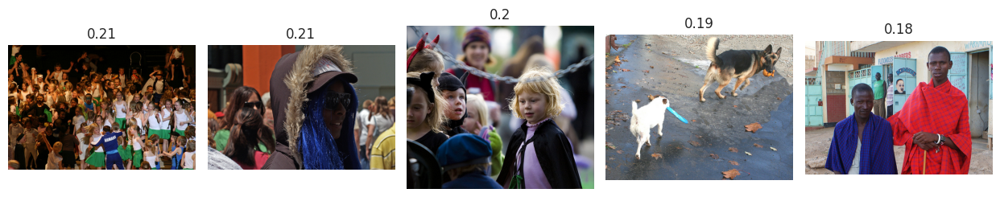

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 

-------------------- A white dog and a black dog in a field --------------------



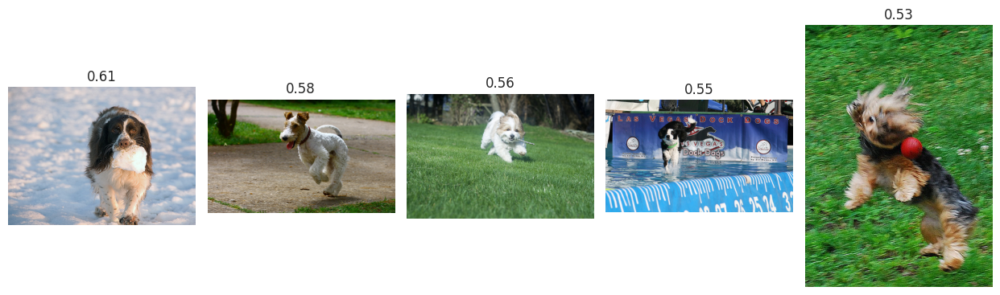

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 

-------------------- Two men are standing under what looks to be a giant robot --------------------



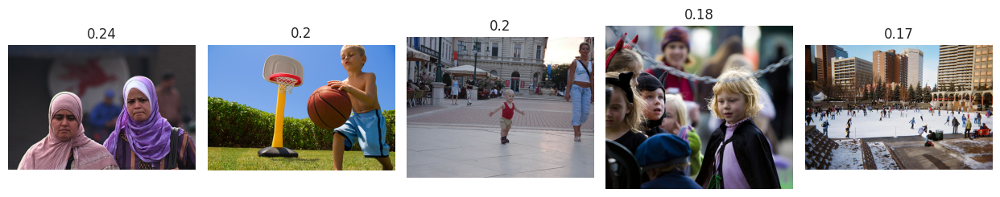

In [71]:
for phrase in queries:
    get_picture(phrase)

попробуем написать рандомные слова

In [72]:
queries2= ['bright field',
            'clear day',
            'fish in a pond',
            'woman crying',
            'party'
           ]

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 

-------------------- bright field --------------------



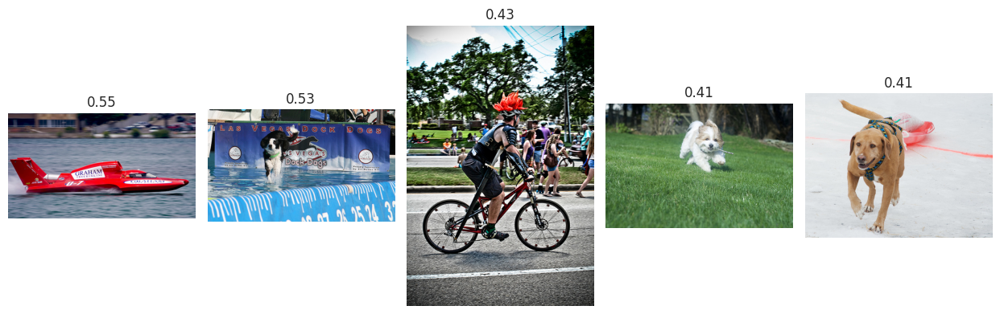

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 

-------------------- clear day --------------------



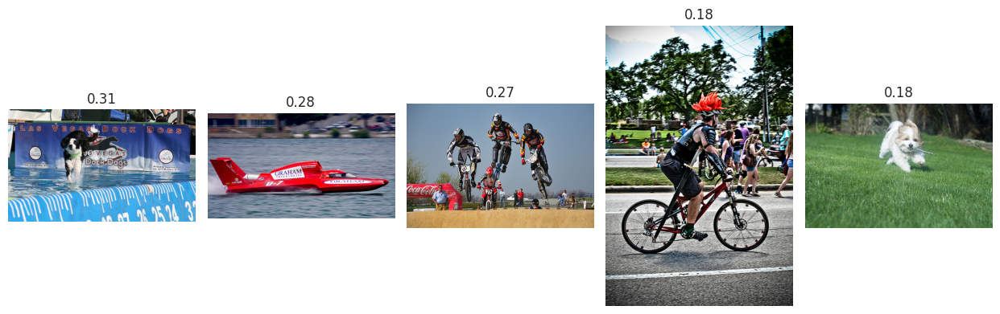

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 

-------------------- fish in a pond --------------------



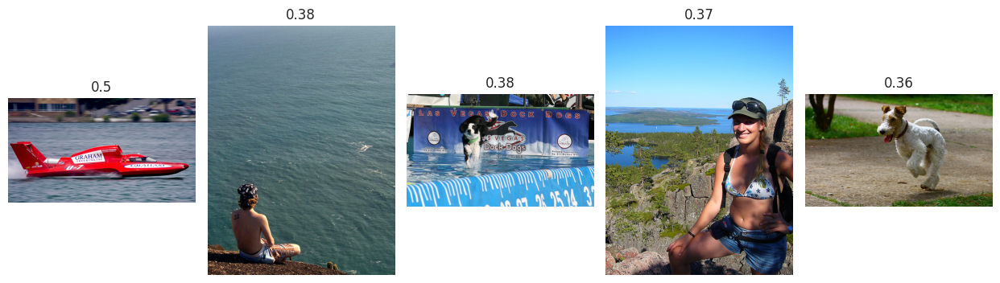

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 

-------------------- woman crying --------------------



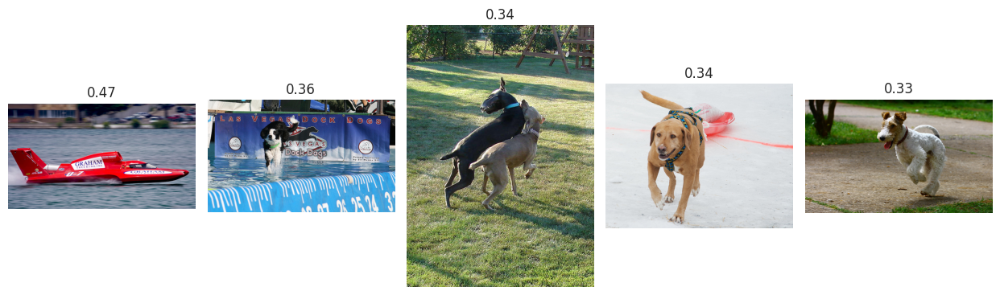

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 

-------------------- party --------------------



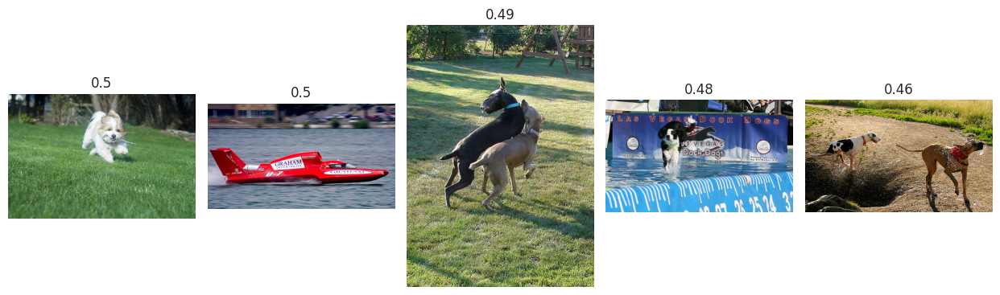

In [73]:
for phrase in queries2:
    get_picture(phrase)

Вывод по главе.
1) Произвели векторизацию текста для получения эмбедингов.
2) Hаписали запрос на вывод наиболее похожих картинов.
3) Определение лучшей картинки верное, но основная проблема в поиске альтернатив. Тематически они не связаны никак.
4) Протестировали модель на нескольки текстовых запросах. Качество оставляет желать лучшего.

<img src="http://s3.amazonaws.com/pix.iemoji.com/images/emoji/apple/ios-12/256/waving-hand.png" align=left width=44, heigth=44>
<div class="alert alert-info">
<b> Идеи и альтернативные подходы</b>
  Если хочешь получить хорошо работающее решение без обучения, то можешь провести эксперимент с нейронной сетью CLIP от OPEN AI (это не обязательно, только если хочешь добиться хороших результатов в этом проекте).

  Про эту нейронку много где написано, но можешь посмотреть например вот здесь  https://habr.com/ru/post/539312/.

  А для написания  реализации наиболее удобной лично для меня оказалась библиотека sbert. https://www.sbert.net/examples/applications/image-search/README.html  
    
    
<hr>    
    
Также неплохо работает следующий подход без предобученных моделей (к тому же легко реализуемый).
    
    
Вместо того, чтобы подавать на вход модели изображение + текст и получать меру соответствия, поступаем по другому. 
    
На вход модели подаем вектор описания, а на выходе учимся предсказывать вектор изображения. 
    
По поводу метрик тут ситуация следующая. Точно работает следующий подход
    
  - берем метрику mse, но тогда нужно чтобы модель её уменьшала. А значит в обучении используем только пары заведомо сответствующие друг другу

Можно попробовать использовать косинусное расстояние, она позволяет использовать все данные (если есть соответствие то выдает 1, если нет то 0). 
    
Также можно попробовать усложнить модель, например и изображения и тексты отправлять в пространство размерностью 256 и уже в этом пространстве учиться их "сближать".
    
По поводу методов векторизации: я бы использовать resnet18 для изображений (размерность эмбеддинга избражения 512) и БЕРТ для текстов (768). 
    
   
</div>

In [74]:
from sentence_transformers import SentenceTransformer, util
from PIL import Image
import glob

# Инициализируем модель CLIP
clip_model = SentenceTransformer('clip-ViT-B-32', device='cpu')

# Загружаем  изображения и получаем их эмбеддинги
image_paths = list(glob.glob(str(Path(PATH, 'test_images', '*.jpg'))))
image_embeddings = clip_model.encode([Image.open(path) for path in image_paths], 
                                    batch_size=32, 
                                    convert_to_tensor=True, 
                                    show_progress_bar=True)

Batches:   0%|          | 0/4 [00:00<?, ?it/s]

In [75]:
def search(query) -> None:

    
    if [i for i in get_lemmas(query) if i in BLOCK]: #проверяем не нужно ли вывести на экран заглушку
        print('')
        print('-' * 20, query, '-' * 20)
        print('')
        print('This image is unavailable in your country in compliance with local laws.')
        print('')
    else:
        query_emb = clip_model.encode([query], convert_to_tensor=True, show_progress_bar=False) #получаем эмбеддинг запроса
# Применяем функцию util.semantic_search для поиска похожих изображений
# Эта функция выполняет следующие шаги:
# 1. Берет эмбеддинг нашего запроса
# 2. Сравнивает его с эмбеддингами всех картинок в базе данных
# 3. Для сравнения используется метод косинусного сходства
# 4. Косинусное сходство показывает, насколько "похожи" векторы эмбеддингов
# 5. Чем ближе косинусное сходство к 1, тем более похожи изображения
# 6. Функция сортирует все картинки по степени сходства
# 7. Возвращает top_k картинок, которые наиболее похожи на наш запрос
# где top_k - это количество картинок, которое мы хотим получить
        hits = util.semantic_search(query_emb, image_embeddings, top_k=5)[0]
        print('')
        print('-' * 20, query, '-' * 20)
        print('')

        fig = plt.figure(figsize=(15,5)) #выводим на экран 5 наиболее похожих картинок
        plt.rcParams['axes.edgecolor'] = 'black'
        plt.rcParams['axes.linewidth'] = 0
        for i in range(5):
            fig.add_subplot(1, 6, i+1, title=round(hits[i]['normalized_score'], 2))
            image = Image.open(image_paths[hits[i]['corpus_id']])
            plt.imshow(image)
            plt.xticks([])
            plt.yticks([])
            plt.tight_layout()
        
        if query in list(test_queries['query_text']): #если текст был в исходном файле с описаниями - добавляем оригинальную картинку
            plt.rcParams['axes.edgecolor'] = 'green'
            plt.rcParams['axes.linewidth'] = 5
            fig.add_subplot(1, 6, 6)
            image = Image.open(Path(PATH, 'test_images', test_queries.iloc[test_queries[test_queries['query_text'] == query].index[0]]['image']))
            plt.imshow(image)
            plt.xticks([])
            plt.yticks([])
            plt.tight_layout()
        
        plt.show()

    return None

In [76]:
samples = test_queries.sample(5)
queries = list(samples['query_text'])
queries

['Five women in red shirts clapping .',
 'Two dogs are wrestling in the park .',
 'A woman and a man pose with Groucho Marx disguises .',
 'A little boy is flying a kite high up in the air .',
 'Little girl on skis']


-------------------- Five women in red shirts clapping . --------------------



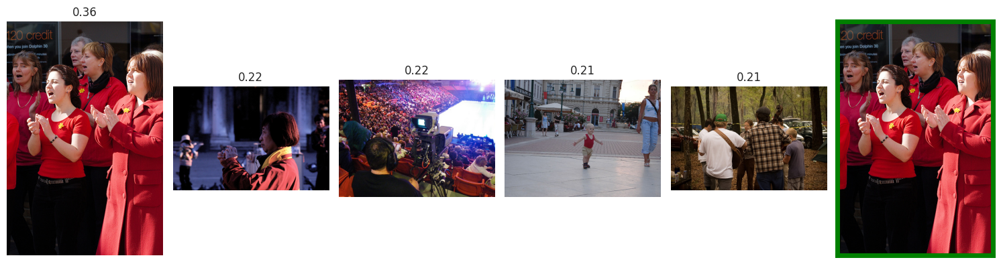


-------------------- Two dogs are wrestling in the park . --------------------



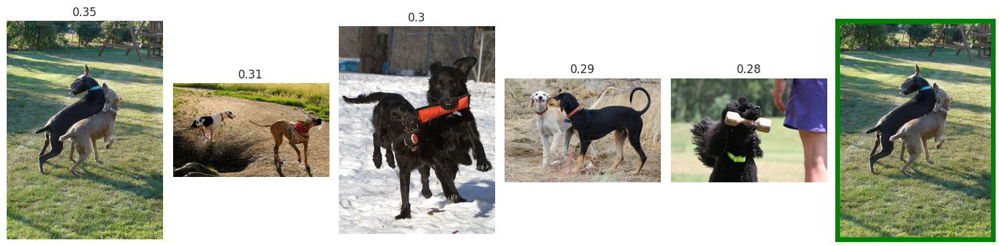


-------------------- A woman and a man pose with Groucho Marx disguises . --------------------



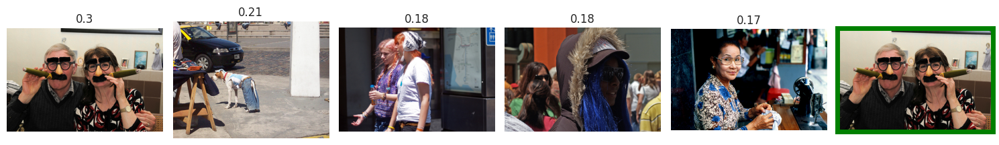


-------------------- A little boy is flying a kite high up in the air . --------------------

This image is unavailable in your country in compliance with local laws.


-------------------- Little girl on skis --------------------

This image is unavailable in your country in compliance with local laws.



In [77]:
for query in queries:
    search(query)

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
    <font size="3"><b>комментарий студента</b></font> 
    
Мы видим, что часто вылетают заглушки на Little girl и little boy, но мы не можем исключить данные слова и добавить их в список блока. Так как это может охначать что угодно от маленькой собачки до лилипута.

А если сравнивать выборку clip и NN она ведет себя гараздо лучше.Спасибо за совет, выбор очевиден.

## Выводы по проекту :
1) Произвели импорты нудныx библиотек и загрузку всех датасетов.
2) изучили информацию , сделали выводы по каждому дотасету.
3) Оставили только мнение экспертов, Краудов не стали брать в рассмотрение.
4) Произвели векторизацию изображений и текста.
5) Hа выбор у нас было 3 модели, лучше всего себя показало NN.
6) Произвели проверку на тренеровочных данных, Результаты далеки от идеала.
7) Один из вариантов решения проблемы глобальный подбор сетей для NN.
8) Дальнейший поиск альтернатив для улучшения качества выборки.
   

<img src="http://s3.amazonaws.com/pix.iemoji.com/images/emoji/apple/ios-12/256/waving-hand.png" align=left width=44, heigth=44>
<div class="alert alert-info">
<b> Заключительный комментарий</b>

Подведем итоги. Я вижу, что в целом с проектом ты справляешься.
    
Проведено исследование и предобработка данных. Выполнена векторизация изображений и текстовых описаний. Обучены модели для предсказания степени соответствия, а также написана функция для инференса и с её помощью проведено тестирование.
 
    
Что нужно доделать обязательно:
    
   - Не нужно бинаризировать оценки. Испльзуй непрерывную шкалу.  
   - Пожалуйста выполни корректную чистку датасета от детских фотографий.
    
Желтые комментарии на твое усмотрение. Но учитывая что наш подход "не взлетел" и нужно хоть что-то показать заказчику, попробуй показать возможный инференс с помщью CLIP. С библиотекой sentence-transformers это делается буквально в 10 строк.    
Жду твою работу на повторное ревью.
</div>

<div class="alert" style="background-color:#ead7f7;color:#8737bf">
    <font size="3"><b>комментарий студента</b></font> 
У меня вопрос не по теме проекта, я потом уберу сообщение это. 
Возможно ты сможешь мне подсказать.
    
Так как я переходила из когорты в когорту у меня пропали 3 проекта, они просто удалились с платформы, я оппрометчиво их не сохранила к себе на компьютер , то есть и у меня их нет.

я обращалась к куратору , но эт безполезно.

Подскажи, есть какой то способ их отыскать, может поспрашивать у проверяющих или еще к кому то обратиться, так как когорт я 2 сменили. но проекты :
1) линейные модели в машинном обучении 
2) обучение с учителем 
3) сборный проект 2